# image segmentation of SUIM dataset

## Data exploration

In [1]:
import pathlib
import time
import matplotlib.pyplot as plt
import seaborn as sns

import numpy as np
import skimage
# from skimage.feature import hog
# from skimage import exposure

import os
os.environ["KERAS_BACKEND"] = "tensorflow"

import keras
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Activation, Flatten, BatchNormalization, Conv2D,AveragePooling2D, MaxPooling2D, Dropout
from keras.optimizers import Adam
from keras.preprocessing.image import ImageDataGenerator

import sklearn
import sklearn.metrics
import sklearn.neighbors
import sklearn.ensemble
from sklearn.metrics import roc_curve, auc

from tqdm.notebook import tqdm

import warnings

print(f"tf version: {tf.__version__}", f", keras version: {keras.__version__}")


ddir = pathlib.Path("data","SUIM")
print(f"We expect the data files in directory {ddir.absolute()}")
(ddir/"logs").mkdir(exist_ok=True)
print(f"The training logs in: {(ddir/'logs').absolute()}")
(ddir/"models").mkdir(exist_ok=True)
(ddir/"models"/"checkpoints").mkdir(exist_ok=True)
(ddir/"models"/"tmp-backups").mkdir(exist_ok=True)
print(f"The trained models in: {(ddir/'models').absolute()}")
(ddir/"npy").mkdir(exist_ok=True)
print(f"The npy files in: {(ddir/'npy').absolute()}")

(ddir/"test"/"patches").mkdir(exist_ok=True)
(ddir/"test"/"patches"/"images").mkdir(exist_ok=True)
(ddir/"test"/"patches"/"masks").mkdir(exist_ok=True)
(ddir/"test"/"patches"/"reduced").mkdir(exist_ok=True)
(ddir/"test"/"patches"/"reduced"/"images").mkdir(exist_ok=True)
(ddir/"test"/"patches"/"reduced"/"masks").mkdir(exist_ok=True)
(ddir/"train_val"/"patches").mkdir(exist_ok=True)
(ddir/"train_val"/"patches"/"images").mkdir(exist_ok=True)
(ddir/"train_val"/"patches"/"masks").mkdir(exist_ok=True)
(ddir/"train_val"/"patches"/"reduced").mkdir(exist_ok=True)
(ddir/"train_val"/"patches"/"reduced"/"images").mkdir(exist_ok=True)
(ddir/"train_val"/"patches"/"reduced"/"masks").mkdir(exist_ok=True)


tf version: 2.15.0 , keras version: 2.15.0
We expect the data files in directory d:\Library\Downloads\Documents\School\SUPSI_23-24\deep_learning\notebooks\data\SUIM
The training logs in: d:\Library\Downloads\Documents\School\SUPSI_23-24\deep_learning\notebooks\data\SUIM\logs
The trained models in: d:\Library\Downloads\Documents\School\SUPSI_23-24\deep_learning\notebooks\data\SUIM\models
The npy files in: d:\Library\Downloads\Documents\School\SUPSI_23-24\deep_learning\notebooks\data\SUIM\npy


In [2]:
def read_image(name, set_="train_val", im_type="images"):
    im = skimage.io.imread(pathlib.Path(ddir, set_, im_type, name))
    if im_type == "masks":
        return skimage.img_as_float(im)
    return im

def get_images(set_="train_val", im_type="images"):
    return [read_image(file.name, set_, im_type) 
            for file in pathlib.Path(ddir, set_, im_type).iterdir() 
            if file.is_file()]
    
def get_filenames(set_="train_val", im_type="images"):
    return [file.name[:-4]
            for file in pathlib.Path(ddir, set_, im_type).iterdir() 
            if file.is_file()]
    
file_names_train_all = get_filenames("train_val", "images")
file_names_test_all  = get_filenames("test", "images")

### !! populating image arrays

In [ ]:
masks_train_all = get_images("train_val", "masks")
masks_test_all = get_images("test", "masks")
ims_train_all = get_images("train_val", "images")
ims_test_all = get_images("test", "images")

print(f"Number of training images: {len(ims_train_all)}")
print(f"Number of test images: {len(ims_test_all)}")

Number of training images: 1525
Number of test images: 110


### Check resolutions

#### plotting resolution distribution

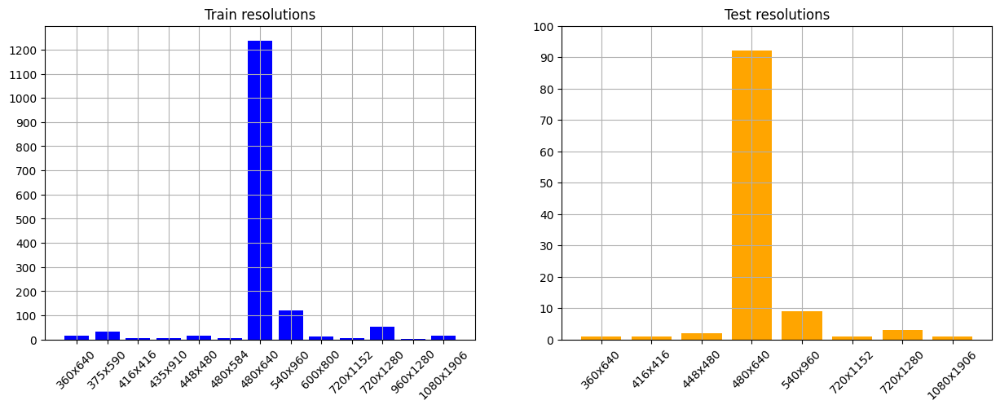

In [4]:
# plot image resolution in bar chart
resolutions_train = ['x'.join(str(i) for i in r) for r in sorted(map(lambda im: (im.shape[0], im.shape[1]),ims_train_all))]
resolutions_test = ['x'.join(str(i) for i in r) for r in sorted(map(lambda im: (im.shape[0], im.shape[1]),ims_test_all))]

fig,axes = plt.subplots(1,2,figsize=(15,5))

def plot_res(resolutions,title,i,color='blue'):
    unique_res = [x for i, x in enumerate(resolutions) if x not in resolutions[:i]]
    res_count = [resolutions.count(x) for x in unique_res]
    axes[i].bar(unique_res, res_count,color=color)
    axes[i].set_title(title)
    axes[i].grid(True)
    plt.setp(axes[i].xaxis.get_majorticklabels(), rotation=45)

plot_res(resolutions_train,'Train resolutions',0)
axes[0].set_yticks(np.arange(0, 1300, 100))
plot_res(resolutions_test,'Test resolutions',1,'orange')
axes[1].set_yticks(np.arange(0, 110, 10))
del resolutions_train, resolutions_test

#### amount of resolutions that differ

In [5]:
# check resolutions percentage
non_480x640_res_train = [(x.shape[0],x.shape[1]) for x in ims_train_all if x.shape != (480, 640,3)]
non_480x640_res_test = [(x.shape[0],x.shape[1]) for x in ims_test_all if x.shape != (480, 640,3)]
unique_res = set([(x.shape[0],x.shape[1]) for x in ims_train_all])
print("------------------train------------------")
print(f"unique resolutions in train: {unique_res}")
print(f"different from resolutions from 480x 640 in train: {len(non_480x640_res_train)}")
print(f"percentage of total {round((len(non_480x640_res_train)/len(ims_train_all))*100,2)}%")

print("------------------test------------------")
print(f"different from resolutions from 480x 640 in test: {len(non_480x640_res_test)}")
print(f"percentage of total {round((len(non_480x640_res_test)/len(ims_test_all))*100,2)}%")

del non_480x640_res_train, non_480x640_res_test, unique_res

------------------train------------------
unique resolutions in train: {(960, 1280), (720, 1280), (435, 910), (448, 480), (1080, 1906), (480, 584), (375, 590), (360, 640), (600, 800), (416, 416), (540, 960), (480, 640), (720, 1152)}
different from resolutions from 480x 640 in train: 288
percentage of total 18.89%
------------------test------------------
different from resolutions from 480x 640 in test: 18
percentage of total 16.36%


#### !! filter dataset for 480x640 res

In [3]:
def drop_by_resolution(data, resolution):
    return [im for im in data if im.shape == resolution]

def drop_by_resolution_index(data, resolution):
    return [i for i,im in enumerate(data) if im.shape != resolution]

dropped_train_idx = drop_by_resolution_index(ims_train_all, (480, 640, 3))
dropped_test_idx = drop_by_resolution_index(ims_test_all, (480, 640, 3))
print("dropped_train: ",len(dropped_train_idx))
print("dropped_test: ",len(dropped_test_idx))

file_names_train = np.array([file_names_train_all[i] for i in range(len(file_names_train_all)) if i not in dropped_train_idx])
ims_train = np.array(drop_by_resolution(ims_train_all, (480, 640, 3)))
masks_train = np.array(drop_by_resolution(masks_train_all, (480, 640, 3)))

file_names_test = np.array([file_names_test_all[i] for i in range(len(file_names_test_all)) if i not in dropped_test_idx])
ims_test = np.array(drop_by_resolution(ims_test_all, (480, 640, 3)))
masks_test = np.array(drop_by_resolution(masks_test_all, (480, 640, 3)))

np.save(pathlib.Path(ddir, "npy", "file_names_train.npy"), file_names_train)
np.save(pathlib.Path(ddir, "npy", "file_names_test.npy"), file_names_test)
np.save(pathlib.Path(ddir, "npy", "ims_train.npy"), ims_train)
np.save(pathlib.Path(ddir, "npy", "ims_test.npy"), ims_test)
np.save(pathlib.Path(ddir, "npy", "masks_train.npy"), masks_train)
np.save(pathlib.Path(ddir, "npy", "masks_test.npy"), masks_test)

# delete unfiltered vars to free memory
del file_names_train_all, file_names_test_all
del ims_train_all, ims_test_all
del masks_train_all, masks_test_all
del dropped_train_idx, dropped_test_idx

print(f"Number of training images after drop: {len(ims_train)}")
print(f"Number of test images after drop: {len(ims_test)}")
print(f"new train: ", len(file_names_train),f"new test: ",len(file_names_test))

NameError: name 'ims_train_all' is not defined

##### load from npy files

In [3]:
file_names_train = np.load(pathlib.Path(ddir, "npy", "file_names_train.npy"))
file_names_test = np.load(pathlib.Path(ddir, "npy", "file_names_test.npy"))
ims_train = np.load(pathlib.Path(ddir, "npy", "ims_train.npy"))
ims_test = np.load(pathlib.Path(ddir, "npy", "ims_test.npy"))
masks_train = np.load(pathlib.Path(ddir, "npy", "masks_train.npy"))
masks_test = np.load(pathlib.Path(ddir, "npy", "masks_test.npy"))

### showing image-mask pairs

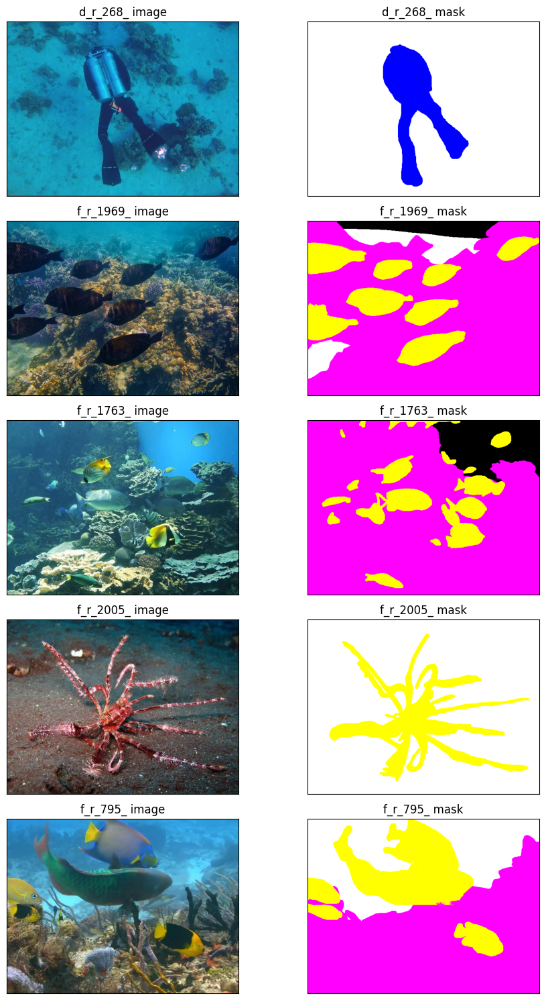

In [455]:
amt = 5
fig,axes = plt.subplots(amt,2,figsize=(10,3*amt))
random_idx = np.random.choice(len(ims_train),amt)
for i in range(amt):
    im = ims_train[random_idx[i]]
    mask = masks_train[random_idx[i]]
    file_name = file_names_train[random_idx[i]]
    # print(im,mask)
    axes[i,0].imshow(im)
    axes[i,1].imshow(mask)
    axes[i,0].set_xticks([])
    axes[i,0].set_yticks([])
    axes[i,1].set_xticks([])
    axes[i,1].set_yticks([])
    axes[i,0].set_title(f"{file_names_train[random_idx[i]]} image")
    axes[i,1].set_title(f"{file_names_train[random_idx[i]]} mask")
plt.tight_layout()

### count fish pixels

#### !! functions

In [4]:
def get_fish_pixels(im):
    return np.sum(np.all(im == (1, 1, 0), axis=-1))

def has_fish_pixel(im):
    return get_fish_pixels(im) > 0

def get_size(im):
    return im.shape[0] * im.shape[1]

## making sure that the function is correct  
# plt.imshow(masks_train[3])
total_fn = get_fish_pixels(masks_train[8])

total_for = 0
for i in masks_train[8]:
    for j in i:
        if j[0] == 1 and j[1] == 1 and j[2] == 0:
            total_for += 1
assert total_for == total_fn
assert has_fish_pixel(masks_train[3]) == True

#### count images that have fish

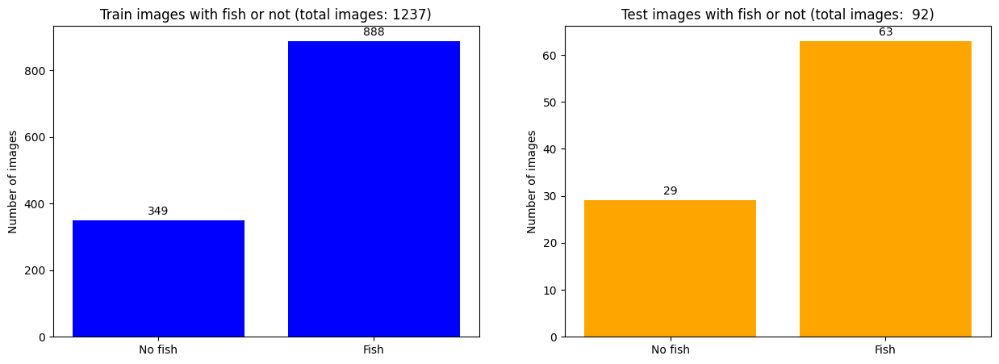

In [10]:
# images that have fish
train_has_fish = [int(has_fish_pixel(im)) for im in masks_train]
test_has_fish = [int(has_fish_pixel(im)) for im in masks_test]
    
bar_labels = ["No fish", "Fish"]
fig,axes = plt.subplots(1,2,figsize=(15,5))

axes[0].bar(bar_labels,[train_has_fish.count(0), train_has_fish.count(1)], color="blue",)
axes[0].set_title(f"Train images with fish or not (total images: {len(ims_train)})")
axes[0].bar_label(axes[0].containers[0], padding=3)
axes[0].set_ylabel("Number of images")

axes[1].bar(bar_labels,[test_has_fish.count(0), test_has_fish.count(1)], color="orange")
axes[1].set_title(f"Test images with fish or not (total images:  {len(ims_test)})")
axes[1].bar_label(axes[1].containers[0], padding=3)
axes[1].set_ylabel("Number of images")

del train_has_fish, test_has_fish

#### % fish pixel per image

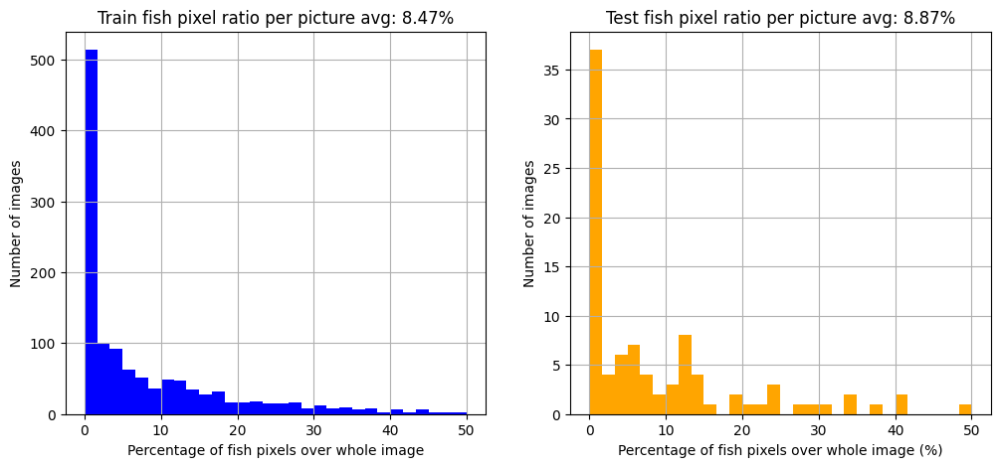

In [11]:
# fish pixels per image
train_pixels = [(get_fish_pixels(im)/get_size(im))*100 for im in masks_train]
test_pixels = [(get_fish_pixels(im)/get_size(im))*100 for im in masks_test]
    
fig,axes = plt.subplots(1,2,figsize=(12,5))
axes[0].hist(train_pixels, bins=30, color="blue", range=(0, 50))
axes[0].set_xlabel("Percentage of fish pixels over whole image")
axes[0].set_ylabel("Number of images")
axes[0].set_title(f"Train fish pixel ratio per picture avg: {round(np.mean(train_pixels),2)}%")
axes[0].grid(True)
axes[1].hist(test_pixels, bins=30, color="orange", range=(0, 50))
axes[1].set_xlabel("Percentage of fish pixels over whole image (%)")
axes[1].set_ylabel("Number of images")
axes[1].set_title(f"Test fish pixel ratio per picture avg: {round(np.mean(test_pixels),2)}%")
axes[1].grid(True)

del train_pixels, test_pixels

#### count fish pixel % over all images

In [12]:
# total fish images

total_fish_pixels = sum(map(get_fish_pixels, masks_train))
total_pixels = sum(map(get_size, masks_train))
print("------------------train------------------")
print(f"fish pixels: {total_fish_pixels}, "
      f"total pixels: {total_pixels}, " 
      f"\n{round((total_fish_pixels/total_pixels)*100,2)}% fish pixels in train")

total_fish_pixels = sum(map(get_fish_pixels, masks_test))
total_pixels = sum(map(get_size, masks_test))
print("------------------test------------------")
print(f"fish pixels: {total_fish_pixels}, "
      f"total pixels: {total_pixels}, " 
      f"\n{round((total_fish_pixels/total_pixels)*100,2)}% fish pixels in test")

del total_fish_pixels, total_pixels

------------------train------------------
fish pixels: 32195447, total pixels: 380006400, 
8.47% fish pixels in train
------------------test------------------
fish pixels: 2507920, total pixels: 28262400, 
8.87% fish pixels in test


## Create patches

### find_path & create_patch

In [9]:
# first get the mask and then find a center pixel within the mask
# then get the image and the mask patch
# then save the patch as a file and return the image and the mask patch

def find_patch(mask, ignore=50, size=10, random=True):
    binary_mask = np.all(mask == (1, 1, 0), axis=-1)
    if random:
        binary_mask = ~binary_mask

    mask_ignored = binary_mask.copy()
    mask_ignored[:ignore, :] = False
    mask_ignored[:, :ignore] = False
    mask_ignored[-ignore:, :] = False
    mask_ignored[:, -ignore:] = False

    rs, cs = np.where(mask_ignored)
    if len(rs) == 0 or len(cs) == 0:
        return None, None
    size = min(size, len(rs))
    ix = np.random.randint(len(rs), size=size)

    return rs[ix], cs[ix]


def process_patch(file, mask, r, c, ignore, type_, set_, save_files,save_mask=False):
    label = np.all(mask[r,c,:] == (1, 1, 0), axis=-1)
    mask_patch = mask[r-ignore: r+ignore, c-ignore: c+ignore]
    image_patch = read_image(f"{file}.jpg", set_, "images")[r-ignore: r+ignore, c-ignore: c+ignore]
    if image_patch.shape != (2*ignore, 2*ignore, 3):
        print(f"Image patch shape is {image_patch.shape} for {file} at {r}, {c}")
    if save_files:
        if save_mask:
            skimage.io.imsave(
                pathlib.Path(ddir, set_, "patches", "masks", f"{file}patch_{r}x{c}_{type_}.bmp"),
                skimage.img_as_ubyte(mask_patch),
                check_contrast=False,
            )
        skimage.io.imsave(
            pathlib.Path(ddir, set_, "patches", "images", f"{file}patch_{r}x{c}_{type_}.jpg"),
            image_patch,
            check_contrast=False,
        )

    return image_patch, label #, mask_patch


def create_patches(set_="train_val", ignore=50, size=10, random=True, all_=False, i=0, save_files=True,save_mask=False):
    type_ = "rnd" if random else "fish"
    filenames = file_names_test if set_ == "test" else file_names_train
    if not all_:
        file = np.random.choice(filenames)
    else:
        file = filenames[i]
    mask = read_image(f"{file}.bmp", set_, "masks")
    if not random and not all_:
        while not has_fish_pixel(mask):
            file = np.random.choice(filenames)
            mask = read_image(f"{file}.bmp", set_, "masks")

    rs, cs = find_patch(mask, size=size, random=random, ignore=ignore)
    if rs is None:
        return None, None, None
    
    # patches, labels, masks = [], [], []
    # for r, c in zip(rs, cs):
    #     image_patch, label, mask_patch = process_patch(file, mask, r, c, ignore, type_, set_, save_files)
    #     patches.append(image_patch)
    #     labels.append(label)
    #     masks.append(mask_patch)

    patches, labels = zip(
        *[
            process_patch(file, mask, r, c, ignore, type_, set_, save_files,save_mask)
            for r, c in zip(rs, cs)
            ]
        )

    return patches, labels #, masks

In [15]:
# first get the mask and then find a center pixel within the mask
# then get the image and the mask patch
# then save the patch as a file and return the image and the mask patch

def find_patch_reduced(mask, ignore=50, size=10, random=True):
    binary_mask = np.all(mask == (1, 1, 0), axis=-1)
    if random:
        binary_mask = ~binary_mask

    mask_ignored = binary_mask.copy()
    mask_ignored[:ignore, :] = False
    mask_ignored[:, :ignore] = False
    mask_ignored[-ignore:, :] = False
    mask_ignored[:, -ignore:] = False

    rs, cs = np.where(mask_ignored)
    if len(rs) == 0 or len(cs) == 0:
        return None, None
    size = min(size, len(rs))
    ix = np.random.randint(len(rs), size=size)

    return rs[ix], cs[ix]


def process_patch_reduced(file, mask, r, c, ignore, type_, set_, save_files,save_mask=False):
    label = np.all(mask[r,c,:] == (1, 1, 0), axis=-1)
    mask_patch = mask[r-ignore: r+ignore, c-ignore: c+ignore]
    image = read_image(f"{file}.jpg", set_, "images")
    image = skimage.transform.resize(image, (int(image.shape[0]//2), int(image.shape[1]//2),3))
    image_patch = image[r-ignore: r+ignore, c-ignore: c+ignore]
    if image_patch.shape != (2*ignore, 2*ignore, 3):
        print(f"Image patch shape is {image_patch.shape} for {file} at {r}, {c}")
    if save_files:
        if save_mask:
            skimage.io.imsave(
                pathlib.Path(ddir, set_, "patches","reduced2", "masks", f"{file}patch_{r*2}x{c*2}_{type_}.bmp"),
                skimage.img_as_ubyte(mask_patch),
                check_contrast=False,
            )
        skimage.io.imsave(
            pathlib.Path(ddir, set_, "patches","reduced2", "images", f"{file}patch_{r*2}x{c*2}_{type_}.jpg"),
            skimage.img_as_ubyte(image_patch),
            check_contrast=False,
        )

    return image_patch, label #, mask_patch


def create_patches_reduced(set_="train_val", ignore=50, size=10, random=True, all_=False, i=0, save_files=True,save_mask=False):
    type_ = "rnd" if random else "fish"
    filenames = file_names_test if set_ == "test" else file_names_train
    if not all_:
        file = np.random.choice(filenames)
    else:
        file = filenames[i]
    mask = read_image(f"{file}.bmp", set_, "masks")
    if not random and not all_:
        while not has_fish_pixel(mask):
            file = np.random.choice(filenames)
            mask = read_image(f"{file}.bmp", set_, "masks")

    mask = skimage.transform.resize(mask, (int(mask.shape[0]//2), int(mask.shape[1]//2),3)).astype(np.float32)
    rs, cs = find_patch_reduced(mask, size=size, random=random, ignore=ignore)
    if rs is None:
        return None, None

    patches, labels = zip(
        *[
            process_patch_reduced(file, mask, r, c, ignore, type_, set_, save_files,save_mask)
            for r, c in zip(rs, cs)
            ]
        )

    return patches, labels

#### Testing/visualising find_patch fn

In [11]:
patches_len_r_tr = []
patches_len_f_tr = []
patches_len_r_te = []
patches_len_f_te = []
no_fish_tr = 0
no_fish_te = 0
size = 15
p_size = 50

# train
for im,mask in zip(ims_train,masks_train):
    # rnd
    rs, cs = find_patch(mask, size=size,random=True,ignore=int(p_size//2))
    if rs is None:
        continue
    assert len(rs) == len(cs)
    patches_len_r_tr.append(rs)

    # fish
    rs, cs = find_patch(mask, size=size,random=False,ignore=int(p_size//2))
    if rs is None:
        no_fish_tr += 1
        continue
    assert len(rs) == len(cs)
    patches_len_f_tr.append(rs)

# test
for im,mask in zip(ims_test,masks_test):
    # rnd
    rs, cs = find_patch(mask, size=size,random=True,ignore=int(p_size//2))
    if rs is None:
        continue
    assert len(rs) == len(cs)
    patches_len_r_tr.append(rs)

    #fish    
    rs, cs = find_patch(mask, size=size,random=False,ignore=int(p_size//2))
    if rs is None:
        no_fish_te += 1
        continue
    assert len(rs) == len(cs)
    patches_len_f_te.append(rs)
    

print(f"---------------- {size} patches per image")
print("train: no fish: ",no_fish_tr)
print("test: no fish: ",no_fish_te)
print("---------------------")
print("train: rnd images with less than desired patches: ",len([x for x in map(len,patches_len_r_tr) if x < size]))
print("test: rnd images with less than desired patches: ",len([x for x in map(len,patches_len_r_te) if x < size]))
print("train: fish images with less than desired patches: ",len([x for x in map(len,patches_len_f_tr) if x < size]))
print("test: fish images with less than desired patches: ",len([x for x in map(len,patches_len_f_te) if x < size]))
print("---------------------")
print("train: min len of patches: ",min(map(len,patches_len_f_tr)))
print("test: min len of patches: ",min(map(len,patches_len_f_tr)))
print("---------------------")
print("train: patches: ",sum(map(len,patches_len_f_tr)), sum(map(len,patches_len_r_tr)),sum(map(len,patches_len_f_tr)) + sum(map(len,patches_len_r_tr)))
print("test: patches: ",sum(map(len,patches_len_f_tr)),sum(map(len,patches_len_r_tr)),sum(map(len,patches_len_f_te)) + sum(map(len,patches_len_r_te)))

del patches_len_r_tr, patches_len_f_tr, patches_len_r_te, patches_len_f_te

---------------- 15 patches per image
train: no fish:  351
test: no fish:  29
---------------------
train: rnd images with less than desired patches:  0
test: rnd images with less than desired patches:  0
train: fish images with less than desired patches:  1
test: fish images with less than desired patches:  0
---------------------
train: min len of patches:  11
test: min len of patches:  11
---------------------
train: patches:  13286 19935 33221
test: patches:  13286 19935 945


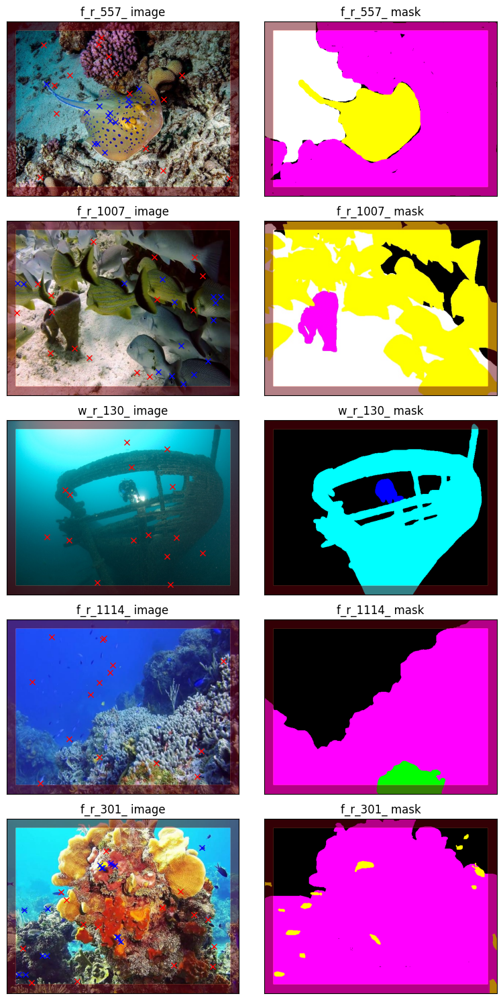

In [458]:
ignore  = 25
frame = np.zeros(ims_train[0].shape[:2])
frame[:ignore,:] = 1
frame[:,:ignore] = 1
frame[-ignore:,:] = 1
frame[:,-ignore:] = 1

#shuffle and pîck at random
amt = 5
random_idxs = np.random.choice(len(ims_train),amt)

fig, axes = plt.subplots(amt, 2, figsize=(8, 3*amt))
for idx,(im,mask) in enumerate(zip(ims_train[random_idxs],masks_train[random_idxs])):
    rs1, cs1 = find_patch(mask, size=15, ignore=ignore)
    rs2, cs2 = find_patch(mask, size=15, ignore=ignore, random=False)

    axes[idx,0].set_title(f"{file_names_train[random_idxs[idx]]} image")
    axes[idx,0].imshow(im)
    axes[idx,0].imshow(frame ,alpha=0.5*(frame>0),cmap="Reds")
    axes[idx,0].plot(cs1, rs1, "rx")
    if rs2 is not None:
        axes[idx,0].plot(cs2,rs2, "bx")
    axes[idx,0].set_xticks([])
    axes[idx,0].set_yticks([])
    
    axes[idx,1].set_title(f"{file_names_train[random_idxs[idx]]} mask")
    axes[idx,1].imshow(mask)
    axes[idx,1].imshow(frame ,alpha=0.5*(frame>0),cmap="Reds")
    axes[idx,1].set_xticks([])
    axes[idx,1].set_yticks([])
    
plt.tight_layout()

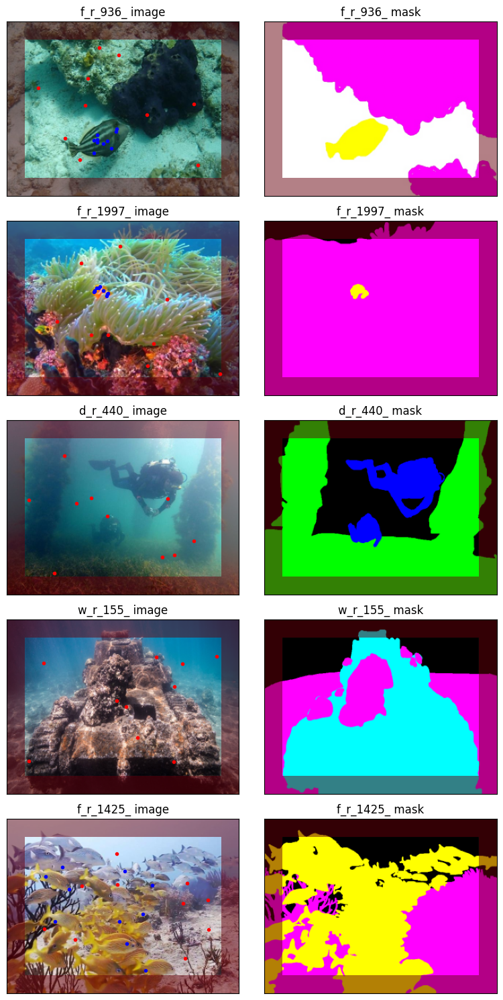

In [423]:
ignore  = 25
frame = np.zeros((ims_train[0].shape[0]//2,ims_train[0].shape[1]//2))
frame[:ignore,:] = 1
frame[:,:ignore] = 1
frame[-ignore:,:] = 1
frame[:,-ignore:] = 1

#shuffle and pîck at random
amt = 5
random_idxs = np.random.choice(len(ims_train),amt)

fig, axes = plt.subplots(amt, 2, figsize=(8, 3*amt))
for idx,(im,mask) in enumerate(zip(ims_train[random_idxs],masks_train[random_idxs])):
    mask = skimage.transform.resize(mask, (int(mask.shape[0]//2), int(mask.shape[1]//2),3))
    rs1, cs1 = find_patch_reduced(mask, size=10, ignore=ignore)
    rs2, cs2 = find_patch_reduced(mask, size=10, ignore=ignore, random=False)

    axes[idx,0].set_title(f"{file_names_train[random_idxs[idx]]} image")
    axes[idx,0].imshow(skimage.transform.resize(im, (int(im.shape[0]//2), int(im.shape[1]//2),3)))
    axes[idx,0].imshow(frame ,alpha=0.5*(frame>0),cmap="Reds")
    axes[idx,0].plot(cs1, rs1, "rx")
    if rs2 is not None:
        axes[idx,0].plot(cs2,rs2, "bx")
    axes[idx,0].set_xticks([])
    axes[idx,0].set_yticks([])
    
    axes[idx,1].set_title(f"{file_names_train[random_idxs[idx]]} mask")
    axes[idx,1].imshow(mask)
    axes[idx,1].imshow(frame ,alpha=0.5*(frame>0),cmap="Reds")
    axes[idx,1].set_xticks([])
    axes[idx,1].set_yticks([])
    
plt.tight_layout()

##### resulting patches for last im

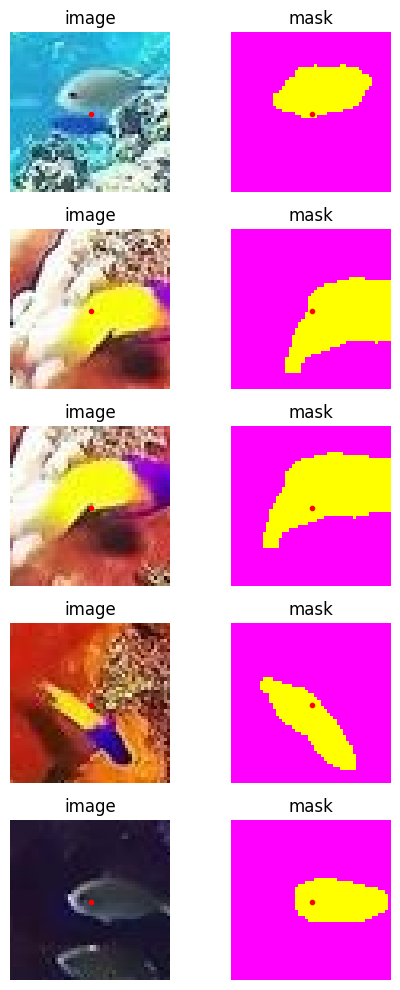

In [459]:
amt = 5

fig, axes = plt.subplots(len(rs2[:amt]),2, figsize=(5, 2*len(rs2[:amt])))
patch_size = 50
for i, (r, c) in enumerate(zip(rs2[:amt], cs2[:amt])):
    axes[i][0].imshow(im[r-patch_size//2:r+patch_size//2, c-patch_size//2:c+patch_size//2, :])
    axes[i][1].imshow(mask[r-patch_size//2:r+patch_size//2, c-patch_size//2:c+patch_size//2,:])
    axes[i][0].axis("off")
    axes[i][1].axis("off")
    axes[i][0].plot(patch_size//2, patch_size//2, "r+")
    axes[i][1].plot(patch_size//2, patch_size//2, "r+")
    axes[i][0].set_title("image")
    axes[i][1].set_title("mask")
plt.tight_layout()

### actually creating patches

In [12]:
def get_patches(images_amount, amount, im_size,set_ ="train_val",all_=True,save_files=True,save_mask=False):
    all_labels, all_patches = [], []
    # masks = []
    # create random patches
    for i in tqdm(range(images_amount),desc="random patches"):
        # patches,labels,masks = create_patches(set_, random=True, size=amount,ignore=im_size//2,all_=all_,i=i,save_files=save_files)
        patches,labels = create_patches(set_, random=True, size=amount,ignore=im_size//2,all_=all_,i=i,save_files=save_files,save_mask=save_mask)
        if patches is None:
            # print(f"{i} no rnd patch found")
            continue    
        all_patches.extend(patches)
        all_labels.extend(labels)
        
    #create fish patches
    for i in tqdm(range(images_amount),desc="fish patches"): 
        # compensate for the fact that there are images without fish based on their ratio
        if not all_:
            if set_ == "test":
                amt = amount + 3
            else:
                amt = amount + 6
        else:
            amt = amount
        # patches,labels,masks = create_patches(set_, random=False, size=amt,ignore=im_size//2,all_=all_,i=i,save_files=save_files)
        patches,labels = create_patches(set_, random=False, size=amt,ignore=im_size//2,all_=all_,i=i,save_files=save_files,save_mask=save_mask)
        if patches is None:
            # print(f"{i} no fish patch found");
            continue    
        all_patches.extend(patches)
        all_labels.extend(labels)
        
    labels = np.array(all_labels)
    patches = np.array(all_patches)
     
    return patches, labels #, masks

In [29]:
def get_patches_reduced(images_amount, amount, im_size,set_ ="train_val",all_=True,save_files=True,save_mask=False):
    all_labels, all_patches = [], []

    for i in tqdm(range(images_amount),desc="random patches"):
        patches,labels = create_patches_reduced(set_, random=True, size=amount,ignore=im_size//2,all_=all_,i=i,save_files=save_files,save_mask=save_mask)
        if patches is None:
            # print(f"{i} no rnd patch found")
            continue    
        all_patches.extend(patches)
        all_labels.extend(labels)
        
    #create fish patches
    # for i in tqdm(range(images_amount),desc="fish patches"): 
    #     # compensate for the fact that there are images without fish based on their ratio
    #     if not all_:
    #         if set_ == "test":
    #             amt = amount + 3
    #         else:
    #             amt = amount + 6
    #     else:
    #         amt = amount
    #     patches,labels = create_patches_reduced(set_, random=False, size=amt,ignore=im_size//2,all_=all_,i=i,save_files=save_files,save_mask=save_mask)
    #     if patches is None:
    #         # print(f"{i} no fish patch found");
    #         continue    
    #     all_patches.extend(patches)
    #     all_labels.extend(labels)
        
    labels = np.array(all_labels)
    patches = np.array(all_patches)
     
    return patches, labels 

#### test fn

In [20]:
# testing if `get_patches()` works correctly

amount = 15
im_size = 50

all_ = False
for set_ in ["train_val","test"]:
    if all_:
        images_amount = 100
    else:
        images_amount = 10
    print(f"------------------{set_}------------------")
    # p,l,_ = get_patches(images_amount, amount, im_size,set_=set_,all_=all_,save_files=False)
    p,l = get_patches(images_amount, amount, im_size,set_=set_,all_=all_,save_files=False)
    if set_=="train_val":
        expected = images_amount*amount + images_amount*(amount+6)
    elif set_=="test":
        expected = images_amount*amount + images_amount*(amount+3)
        
    print("amount of patches: ",len(p), f", expected: +-{expected}") # it will be slightly off if all_ = false
    print("p: ",p.shape,"l: ",l.shape)

    if not all_:
        if set_=="train_val":
            assert len(p) == images_amount*amount + images_amount*(amount+6)
        elif set_=="test":
            assert len(p) == images_amount*amount + images_amount*(amount+3)
    else:
        pass
        # if set_=="train_val":
        #     assert abs(len(p) - (images_amount*amount + images_amount*(amount+6))) < x
        # elif set_=="test":
        #     assert abs(len(p) - (images_amount*amount + images_amount*(amount+3))) < x
del p,l

------------------train_val------------------


random patches:   0%|          | 0/10 [00:00<?, ?it/s]

fish patches:   0%|          | 0/10 [00:00<?, ?it/s]

amount of patches:  360 , expected: +-360
p:  (360, 50, 50, 3) l:  (360,)
------------------test------------------


random patches:   0%|          | 0/10 [00:00<?, ?it/s]

fish patches:   0%|          | 0/10 [00:00<?, ?it/s]

amount of patches:  330 , expected: +-330
p:  (330, 50, 50, 3) l:  (330,)


#### training set

In [49]:
# # #extract 10x more

# images_amount = len(ims_train) # 1237 x 15 patches per image x2 (random and fish) = 37_050
# amount = 15
# im_size = 50

## patches_train, labels_train,  _ = get_patches(images_amount, amount, im_size,"train_val")
# patches_train, labels_train = get_patches(images_amount, amount, im_size,"train_val")
# print("amount of patches: ",len(patches_train))
# print(patches_train.shape)

# # save patches and labels to npy files
# np.save(pathlib.Path(ddir, "npy", "patches_train.npy"), patches_train)
# np.save(pathlib.Path(ddir, "npy", "labels_train.npy"), labels_train)

##### reduced

In [36]:
# #extract 10x more

# images_amount = len(ims_train) # 1237 x 15 patches per image x2 (random and fish) = 37_050
images_amount = 9
amount = 10
im_size = 100

patches_train, labels_train = get_patches_reduced(images_amount, amount, im_size,"train_val",save_mask=True,all_=False)
# patches_train, labels_train = get_patches_reduced(images_amount, amount, im_size,"train_val",all_=False)
print("amount of patches: ",len(patches_train))
print(patches_train.shape)

# save patches and labels to npy files
np.save(pathlib.Path(ddir, "npy", "patches_train_reduced_100.npy"), patches_train)
np.save(pathlib.Path(ddir, "npy", "labels_train_reduced_100.npy"), labels_train)

random patches:   0%|          | 0/9 [00:00<?, ?it/s]

amount of patches:  90
(90, 100, 100, 3)


In [40]:
del ims_train, masks_train

#### testing set

In [48]:
# images_amount = len(ims_test) # 92 x 15 patches per image x2 (random and fish) = 2_760
# amount = 15
# im_size = 50
    
## patches_test,labels_test,  _ = get_patches(images_amount, amount, im_size,"test") 
# patches_test,labels_test = get_patches(images_amount, amount, im_size,"test") 
# print("amount of patches: ",len(patches_test))
# print(patches_test.shape)

# # save patches and labels to npy files
# np.save(pathlib.Path(ddir, "npy", "patches_test.npy"), patches_test)
# np.save(pathlib.Path(ddir, "npy", "labels_test.npy"), labels_test)

##### reduced

In [35]:
# images_amount = len(ims_test) # 92 x 15 patches per image x2 (random and fish) = 2_760
images_amount = 2
amount = 10
im_size = 100
    
patches_test,labels_test = get_patches_reduced(images_amount, amount, im_size,"test",save_mask=True,all_=False) 
# patches_test,labels_test = get_patches_reduced(images_amount, amount, im_size,"test",all_=False) 
print("amount of patches: ",len(patches_test))
print(patches_test.shape)

# save patches and labels to npy files
np.save(pathlib.Path(ddir, "npy", "patches_test_reduced_100.npy"), patches_test)
np.save(pathlib.Path(ddir, "npy", "labels_test_reduced_100.npy"), labels_test)

random patches:   0%|          | 0/2 [00:00<?, ?it/s]

amount of patches:  20
(20, 100, 100, 3)


In [41]:
del ims_test, masks_test

#### !! load made patches

##### from dir

In [25]:
# set orig to True if you didn't save the mask images for each patch

def get_patch(name, set_="train_val",orig=True):
    patches_path = pathlib.Path(ddir, set_, "patches", "images")
    patch = skimage.io.imread(pathlib.Path(patches_path, f"{name}.jpg"))
    label_name = name.split("_")[-1].strip(".jpg")
    label = True if label_name == "fish" else False
    # if orig: 
    #     orig_name = '_'.join(name.split("_")[:3]) + '_'
    #     orig_mask = skimage.img_as_float(skimage.io.imread(pathlib.Path(ddir, set_, "masks", f"{orig_name}.bmp")))
    #     orig_center = name.split("_")[4].split("x")
    #     label = np.all(orig_mask[orig_center[0],orig_center[1],:] == (1, 1, 0), axis=-1)
    # else:   
    #     mask = skimage.img_as_float(skimage.io.imread(pathlib.Path(ddir, set_, "patches", "masks", f"{name}.bmp")))
    #     patch_center = np.array(patch.shape[:2])//2
    #     label = np.all(mask[patch_center[0],patch_center[1],:] == (1, 1, 0), axis=-1)
    return patch,label

get_train = [get_patch(name, "train_val") for name in tqdm(get_filenames("train_val", "patches/images"),desc="train_val")]
get_test = [get_patch(name, "test") for name in tqdm(get_filenames("test", "patches/images"),desc="test")]
patches_train = np.array([res[0] for res in get_train])
labels_train = np.array([res[1] for res in get_train])
patches_test = np.array([res[0] for res in get_test])
labels_test = np.array([res[1] for res in get_test])
print(patches_train.shape, labels_train.shape, patches_test.shape, labels_test.shape,sep="\n")

train_val:   0%|          | 0/37093 [00:00<?, ?it/s]

test:   0%|          | 0/2828 [00:00<?, ?it/s]

(37093, 50, 50, 3)
(37093,)
(2828, 50, 50, 3)
(2828,)


In [37]:
def get_patch(name, set_="train_val"):
    patches_path = pathlib.Path(ddir, set_, "patches","reduced2", "images")
    patch = skimage.io.imread(pathlib.Path(patches_path, f"{name}.jpg"))
    label_name = name.split("_")[-1].strip(".jpg")
    label = True if label_name == "fish" else False
    # orig_name = ''.join(name.split("_")[:2])
    # orig_mask = skimage.img_as_float(skimage.io.imread(pathlib.Path(ddir, set_, "masks", f"{orig_name}.bmp")))
    # orig_center = name.split("_")[4].split("x")
    # label = np.all(orig_mask[orig_center[0],orig_center[1],:] == (1, 1, 0), axis=-1)
    return patch,label

get_train = [get_patch(name, "train_val") for name in tqdm(get_filenames("train_val", "patches/reduced2/images"),desc="train_val")]
get_test = [get_patch(name, "test") for name in tqdm(get_filenames("test", "patches/reduced2/images"),desc="test")]
patches_train = np.array([res[0] for res in get_train])
labels_train = np.array([res[1] for res in get_train])
patches_test = np.array([res[0] for res in get_test])
labels_test = np.array([res[1] for res in get_test])
print(patches_train.shape, labels_train.shape, patches_test.shape, labels_test.shape,sep="\n")

train_val:   0%|          | 0/25704 [00:00<?, ?it/s]

test:   0%|          | 0/1981 [00:00<?, ?it/s]

(25704, 100, 100, 3)
(25704,)
(1981, 100, 100, 3)
(1981,)


###### save into npy

In [28]:
# np.save(pathlib.Path(ddir, "npy", "patches_train.npy"), patches_train)
# np.save(pathlib.Path(ddir, "npy", "labels_train.npy"), labels_train)
# np.save(pathlib.Path(ddir, "npy", "patches_test.npy"), patches_test)
# np.save(pathlib.Path(ddir, "npy", "labels_test.npy"), labels_test)

In [ ]:
np.save(pathlib.Path(ddir, "npy", "patches_train_reduced_100.npy"), patches_train)
np.save(pathlib.Path(ddir, "npy", "labels_train_reduced_100.npy"), labels_train)
np.save(pathlib.Path(ddir, "npy", "patches_test_reduced_100.npy"), patches_test)
np.save(pathlib.Path(ddir, "npy", "labels_test_reduced_100.npy"), labels_test)

##### from npy files

In [5]:
patches_train = np.load(pathlib.Path(ddir, "npy", "patches_train.npy"))
labels_train = np.load(pathlib.Path(ddir, "npy", "labels_train.npy"))
patches_test = np.load(pathlib.Path(ddir, "npy", "patches_test.npy"))
labels_test = np.load(pathlib.Path(ddir, "npy", "labels_test.npy"))
print(len(patches_train), len(labels_train), len(patches_test), len(labels_test))

37093 37093 2828 2828


In [44]:
patches_train = np.load(pathlib.Path(ddir, "npy", "patches_train_reduced.npy"))
labels_train = np.load(pathlib.Path(ddir, "npy", "labels_train_reduced.npy"))
patches_test = np.load(pathlib.Path(ddir, "npy", "patches_test_reduced.npy"))
labels_test = np.load(pathlib.Path(ddir, "npy", "labels_test_reduced.npy"))
print(len(patches_train), len(labels_train), len(patches_test), len(labels_test))

37128 37128 2763 2763


In [33]:
train_vals,train_cnt = np.unique(labels_train, return_counts=True)
test_vals,test_cnt = np.unique(labels_test, return_counts=True)
print(f"train: {dict(zip(train_vals,train_cnt))}",f"test: {dict(zip(test_vals,test_cnt))}",sep="\n")

train: {False: 18555, True: 18538}
test: {False: 1380, True: 1448}


In [24]:
# files = [file.name for file in pathlib.Path(ddir, "train_val", "patches","reduced", "images").iterdir() if file.is_file()]
# labels_train = np.array([False if file.split("_")[5][:-4] == "rnd" else True for file in files])
# patches_train = np.array([skimage.io.imread(pathlib.Path(ddir, "train_val", "patches","reduced", "images", file)) for file in files])

### checking how many of each patch

In [38]:
# lst_train = [file.name.split("_")[-1][:-4] for file in pathlib.Path(ddir, "train_val", "patches", "masks").iterdir() if file.is_file()]
# lst_train = [file.name.split("_")[-1][:-4] for file in pathlib.Path(ddir, "train_val", "patches","reduced", "images").iterdir() if file.is_file()]
print("------------------train------------------")
print("fish patches: ",f"{np.sum(labels_train)}, {round(np.sum(labels_train)/len(labels_train)*100,4)}%")
print("rnd patches: ",f"{np.sum(labels_train==0)} {round(np.sum(labels_train==0)/len(labels_train)*100,4)}%")

# lst_test = [file.name.split("_")[-1][:-4] for file in pathlib.Path(ddir, "test", "patches", "masks").iterdir() if file.is_file()]
# lst_test = [file.name.split("_")[-1][:-4] for file in pathlib.Path(ddir, "test", "patches","reduced", "images").iterdir() if file.is_file()]
print("------------------test------------------")
print("fish patches: ",f"{np.sum(labels_test)} {round(np.sum(labels_test)/len(labels_test)*100,4)}%")
print("rnd patches: ",f"{np.sum(labels_test==0)} {round(np.sum(labels_test==0)/len(labels_test)*100,4)}%")

# del lst_train, lst_test

------------------train------------------
fish patches:  12847, 49.9805%
rnd patches:  12857 50.0195%
------------------test------------------
fish patches:  991 50.0252%
rnd patches:  990 49.9748%


### visualizing some patches and their labels

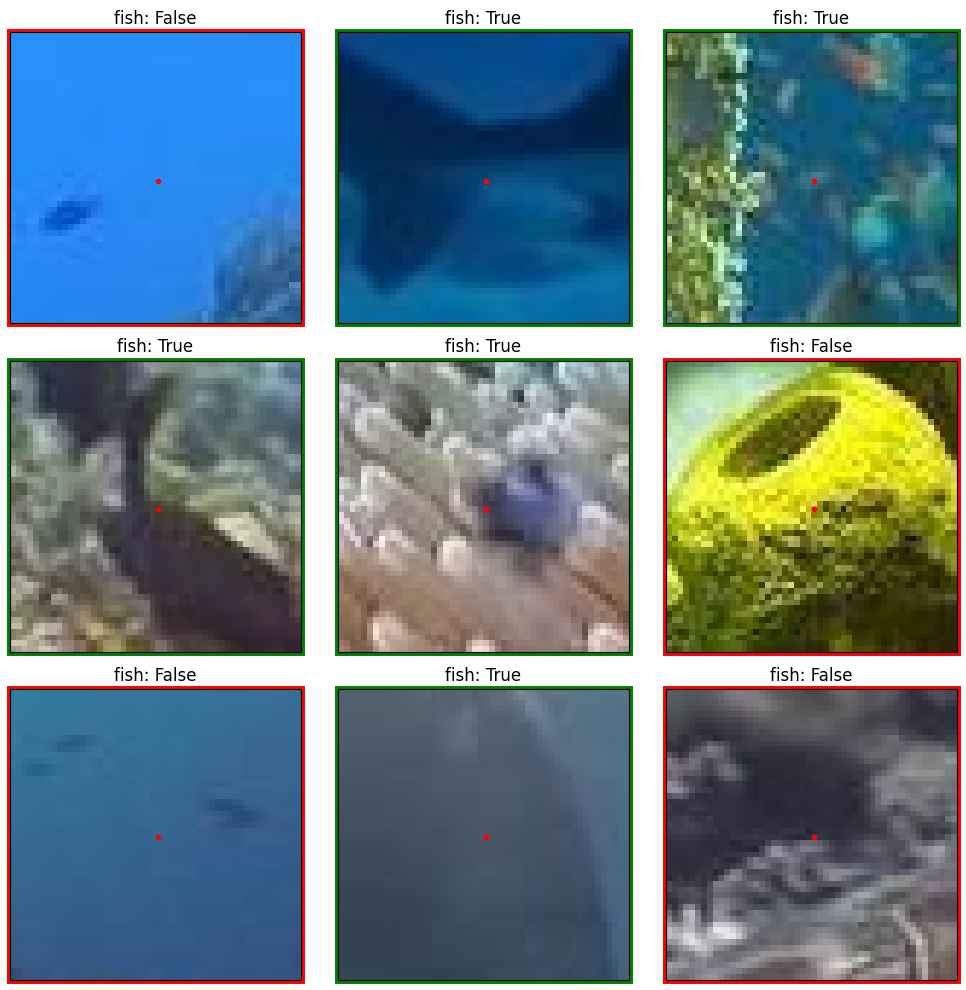

In [24]:
fig,axes = plt.subplots(3,3,figsize=(10,10))

#shuffle and pîck at random
random_idx = np.random.choice(len(patches_train),9)

for i,(patch,label) in enumerate(zip(patches_train[random_idx],labels_train[random_idx])):
    axes[i//3,i%3].imshow(patch)
    axes[i//3,i%3].set_title(f"fish: {label}")
    axes[i//3,i%3].xaxis.set_visible(False)
    axes[i//3,i%3].yaxis.set_visible(False)
    if label == True:
        axes[i//3,i%3].patch.set_linewidth(5)
        axes[i//3,i%3].patch.set_edgecolor('green')
    else:
        axes[i//3,i%3].patch.set_linewidth(5)
        axes[i//3,i%3].patch.set_edgecolor('red')
    axes[i//3,i%3].plot(patch.shape[0]//2, patch.shape[1]//2, "r.")
plt.tight_layout()

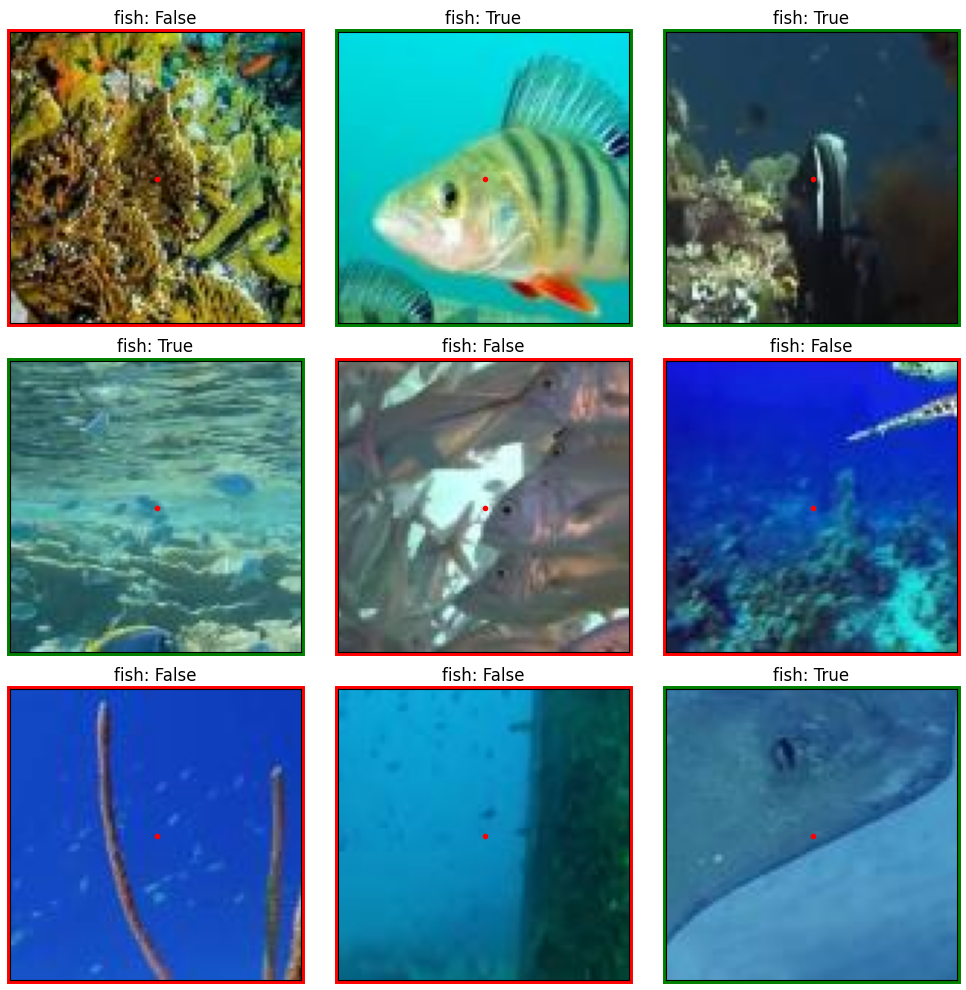

In [39]:
fig,axes = plt.subplots(3,3,figsize=(10,10))

#shuffle and pîck at random
random_idx = np.random.choice(len(patches_train),9)

for i,(patch,label) in enumerate(zip(patches_train[random_idx],labels_train[random_idx])):
    axes[i//3,i%3].imshow(patch)
    axes[i//3,i%3].set_title(f"fish: {label}")
    axes[i//3,i%3].xaxis.set_visible(False)
    axes[i//3,i%3].yaxis.set_visible(False)
    if label == True:
        axes[i//3,i%3].patch.set_linewidth(5)
        axes[i//3,i%3].patch.set_edgecolor('green')
    else:
        axes[i//3,i%3].patch.set_linewidth(5)
        axes[i//3,i%3].patch.set_edgecolor('red')
    axes[i//3,i%3].plot(patch.shape[0]//2, patch.shape[1]//2, "r.")
plt.tight_layout()

## Training simple classification
- Decide on a meaningful split between training/validation/testing data
  - Initially, you can “cheat” by setting validation==testing.
- Implement a segmentation-by-classification approach
    - Build **training and testing datasets** from training and testing images
    - Given an input patch cropped around pixel p, classify the pixel as class 1 or class 2
    - Start very simple (e.g.the **RGB values** of the pixel itself + a logistic **regressor**). 
      - Then move up to more sophisticated approaches (e.g. a very **simple CNN** that takes a **15x15 patch** centered on the pixel)
    - Compute binary classification metrics (**accuracy, AUC**) on the testing dataset
    - **Apply the model densely** on a few testing images and visualize the **resulting masks**


### predict using KNN, RandomForest, LogisticRegression

#### !! helper functions

In [6]:
def learn(fun_features,cl="knn"):
    features_train = []
    for im in patches_train:
        features_train.append(fun_features(im.astype(float)/255))
    features_train = np.array(features_train)

    features_test = []
    for im in patches_test:
        features_test.append(fun_features(im.astype(float)/255))
    features_test = np.array(features_test)

    if cl == "knn":
        clf = sklearn.neighbors.KNeighborsClassifier(n_neighbors=28)
        clf.fit(features_train, labels_train)
    if cl == "lr":
        clf = sklearn.linear_model.LogisticRegression(max_iter=100,solver="newton-cg",C=100)
        clf.fit(features_train, labels_train)
    if cl == "rf":
        clf = sklearn.ensemble.RandomForestClassifier(n_estimators=100, max_depth=20)
        clf.fit(features_train, labels_train)
    labels_pred = clf.predict(features_test)
    labels_prob = np.array(clf.predict_proba(features_test))[:,1] #why is it double?
    print(f"Accuracy: {sklearn.metrics.accuracy_score(labels_test, labels_pred)}")
  
    return labels_pred,labels_prob,clf


def plot_AUC(labels_test,labels_prob,title="",figsize=(4,4)):
    if isinstance(labels_prob,dict):
        fprs = []
        tprs = []
        roc_aucs = []
        for key in labels_prob.keys():
            fpr, tpr, _ = roc_curve(labels_test, labels_prob[key])
            roc_auc = auc(fpr, tpr)
            fprs.append(fpr)
            tprs.append(tpr)
            roc_aucs.append(roc_auc)
    else:
        fpr, tpr, _ = roc_curve(labels_test, labels_prob)
        roc_auc = auc(fpr, tpr)

    # Plot ROC curve
    plt.figure(figsize=figsize)
    if isinstance(labels_prob,dict):
        for i in range(len(fprs)):
            plt.plot(fprs[i], tprs[i], lw=2, label=f'{list(labels_prob.keys())[i]} (AUC = {round(roc_aucs[i],2)})')
    else:
        plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (AUC = {:.2f})'.format(roc_auc))
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--', label='Random classifier')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve '+title)
    plt.legend(loc='lower right')
    plt.grid(True)
    plt.show()
    
    return roc_auc
    
    
def plot_confustion_matrix(labels_test, labels_pred,percent=False):
    acc = np.mean(labels_test == labels_pred)
    if percent:
        cm = sklearn.metrics.confusion_matrix(y_true=labels_test, y_pred=labels_pred,normalize="true")
        fmt = '.0%'
    else:
        cm = sklearn.metrics.confusion_matrix(y_true=labels_test, y_pred=labels_pred)
        fmt = 'd'
    sns.heatmap(cm, annot=True, xticklabels=["Fish", "Not fish"], yticklabels=["Fish", "Not fish"], fmt=fmt)
    plt.xlabel('Prediction', fontsize = 12) 
    plt.ylabel('Truth', fontsize = 12) 
    plt.title(f"Confusion Matrix testing instances (acc={acc:.0%})", fontsize = 15)
    return cm

In [37]:
print(labels_train.shape,labels_test.shape)
print(labels_train[:5],labels_test[:5],sep="\n")

(37093,) (2828,)
[False False False False False]
[ True False  True  True  True]


#### Using RGB values

##### center pixel only

In [8]:
def extract_features(im):
    center = np.array(im.shape[:2])//2
    return np.array(im[center[0],center[1],:])

In [9]:
print(f"KNN:")
labels_pred_knn, labels_prob_knn, _ = learn(extract_features,"knn")
print(f"LR:")
labels_pred_lr, labels_prob_lr,_ = learn(extract_features,"lr")
print(f"RF:")
labels_pred_rf, labels_prob_rf,_ = learn(extract_features,"rf")

KNN:
Accuracy: 0.6007779349363508
LR:
Accuracy: 0.6368458274398868
RF:
Accuracy: 0.5908769448373409


###### AUC

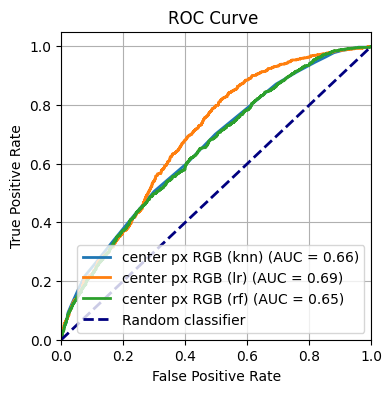

0.6503428016654655

In [10]:
d = {
    "center px RGB (knn)": labels_prob_knn,
    "center px RGB (lr)": labels_prob_lr,
    "center px RGB (rf)": labels_prob_rf,
}
plot_AUC(labels_test,d)

# plot_AUC(labels_test,labels_prob_knn,": center px RGB (knn)")
# plot_AUC(labels_test,labels_prob_lr,": center px RGB (lr)")
# plot_AUC(labels_test,labels_prob_rf,": center px RGB (rf)")

###### confusion matrix

In [ ]:
# plot_confustion_matrix(labels_test, labels_pred_knn,percent=True)
# plot_confustion_matrix(labels_test, labels_pred_lr,percent=True)
# plot_confustion_matrix(labels_test, labels_pred_rf,percent=True)

##### !! Center 10x10 pixels

In [11]:
def extract_features(im):
    size = 10
    center = np.array(im.shape[:2])//2
    return np.array([im[center[0]-size//2:center[0]+size//2,center[1]-size//2:center[1]+size//2,:]]).flatten()

In [12]:
print(f"KNN:")
labels_pred_knn, labels_prob_knn,_ = learn(extract_features,"knn")
print(f"LR:")
labels_pred_lr, labels_prob_lr, _ = learn(extract_features,"lr")
print(f"RF:")
labels_pred_rf, labels_prob_rf,clf_rf = learn(extract_features,"rf")

KNN:


Accuracy: 0.6545261669024045
LR:
Accuracy: 0.6432107496463932
RF:
Accuracy: 0.7160537482319661


###### AUC

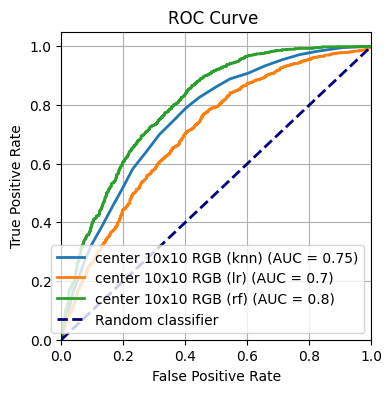

0.7984801625430378

In [13]:
d = {
    "center 10x10 RGB (knn)":labels_prob_knn,
    "center 10x10 RGB (lr)":labels_prob_lr,
    "center 10x10 RGB (rf)":labels_prob_rf
}
plot_AUC(labels_test,d)

# plot_AUC(labels_test,labels_prob_knn,": center 10x10 RGB (knn)")
# plot_AUC(labels_test,labels_prob_lr,": center 10x10 RGB (lr)")
# plot_AUC(labels_test,labels_prob_rf,": center 10x10 RGB (rf)")

###### Confusion matrix

In [ ]:
# plot_confustion_matrix(labels_test, labels_pred_knn,percent=True)
# plot_confustion_matrix(labels_test, labels_pred_lr,percent=True)
# plot_confustion_matrix(labels_test, labels_pred_rf,percent=True)

##### Center 20x20 px

In [ ]:
# def extract_features(im):
#     size = 20
#     center = np.array(im.shape[:2])//2
#     return np.array([im[center[0]-size//2:center[0]+size//2,center[1]-size//2:center[1]+size//2,:]]).flatten()

In [ ]:
# print(f"KNN:")
# labels_pred_knn, labels_prob_knn,_ = learn(extract_features,"knn")
# print(f"LR:")
# labels_pred_lr, labels_prob_lr,_ = learn(extract_features,"lr")
# print(f"RF:")
# labels_pred_rf, labels_prob_rf,clf_rf2 = learn(extract_features,"rf")

In [ ]:
# plot_AUC(labels_test,labels_prob_knn,": center 20x20 RGB (knn)")
# plot_AUC(labels_test,labels_prob_lr,": center 20x04 RGB (lr)")
# plot_AUC(labels_test,labels_prob_rf,": center 20x20 RGB (rf)")

## Image preprocessing

###  Data augmentations

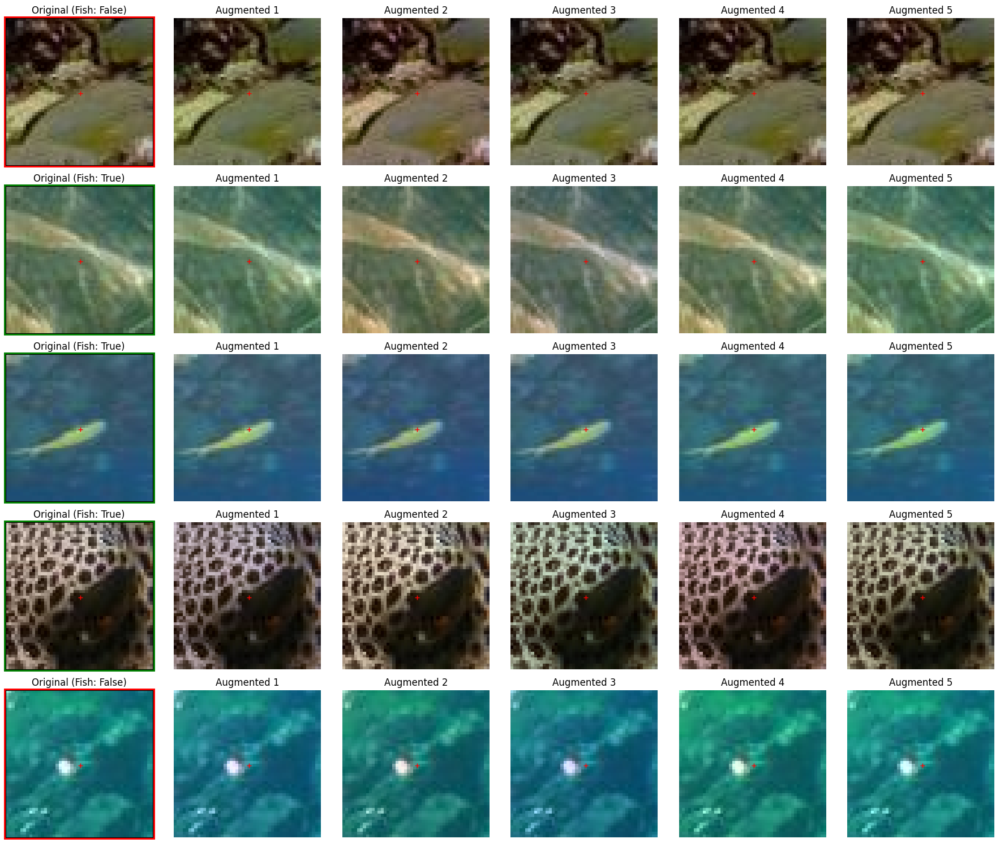

In [54]:
nr_images = 5
nr_augments = 6
sample_idx = np.random.choice(len(patches_train),nr_images)
sample_images = patches_train[sample_idx]

#if you want to do it inline with your model input following syntax:
    # data_augmentation = keras.Sequential(
    #     [
    #         layers.RandomFlip("horizontal"),
    #         layers.RandomRotation(0.1),
    #         layers.RandomZoom(0.1),
    #     ]
    # )
    
def shift_color(im):
    if True:
        im = skimage.img_as_float(sample_image)
        im = im*np.random.uniform(.9,1.1,size=(1,1,3))
        im = np.clip(im,0,1)
        # im = skimage.img_as_ubyte(im)
    return im

datagen = ImageDataGenerator(        
    rotation_range=45,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    brightness_range=(0.75,1),
    fill_mode='nearest',
    preprocessing_function = shift_color
)

n_rows = nr_images
n_cols = nr_augments
fig, axes = plt.subplots(n_rows, n_cols, figsize=(3*n_cols, 3*n_rows))

for i, sample_image in enumerate(sample_images):
    sample_image = sample_image
    label = labels_train[sample_idx[i]]
    sample_image.shape = (1,) + sample_image.shape
    augmented_images = datagen.flow(sample_image.astype(float)/255, batch_size=nr_augments)

    # Display the original image
    axes[i, 0].imshow(sample_image[0])
    axes[i, 0].plot(sample_image.shape[2]//2, sample_image.shape[1]//2, "r+")
    axes[i, 0].set_xticks([])
    axes[i, 0].set_yticks([])
    axes[i, 0].set_title(f'Original (Fish: {label})')
    if label == True:
        axes[i, 0].patch.set_linewidth(5)
        axes[i, 0].patch.set_edgecolor('green')
    else:
        axes[i, 0].patch.set_linewidth(5)
        axes[i, 0].patch.set_edgecolor('red')

    # Display the augmented images
    for j in range(1, n_cols):
        augmented_batch = augmented_images.next()
        augmented_image = augmented_batch[0]
        # augmented_image = augmented_batch[0]
        axes[i, j].imshow(augmented_image)
        axes[i, j].plot(sample_image.shape[2]//2, sample_image.shape[1]//2, "r+")
        axes[i, j].axis('off')
        axes[i, j].set_title(f'Augmented {j}')


    # plt.subplots_adjust(wspace=0.5)
plt.tight_layout()
plt.show()

del sample_images, sample_idx, augmented_images, augmented_batch, augmented_image

In [35]:
# Take image and resize to a specified size, after applying data augmentation
def transform_complex(im,sz):
    if(np.random.rand()<0.5):
        im=np.fliplr(im)
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        tf1 = skimage.transform.SimilarityTransform(scale = 1 / im.shape[0])
        tf2 = skimage.transform.SimilarityTransform(translation=[-0.5, -0.5])
        tf3 = skimage.transform.SimilarityTransform(rotation=np.deg2rad(np.random.uniform(0,360)))
        tf4 = skimage.transform.SimilarityTransform(scale=np.random.uniform(1,1.6))
        tf5 = skimage.transform.SimilarityTransform(translation=np.array([0.5, 0.5])+np.random.uniform(-0.1,0.1,size=2))
        tf6 = skimage.transform.SimilarityTransform(scale=sz)
        imr = skimage.transform.warp(im, (tf1+(tf2+(tf3+(tf4+(tf5+tf6))))).inverse, output_shape=(sz,sz),mode="edge")
        imr = imr*np.random.uniform(0.9,1.1,size=(1,1,3))
        imr = np.clip(imr,0,1)
    return imr

transform = transform_complex

def sample(df,sz):
    r = df.sample(n=1)
    l = r["label"].iloc[0]
    im = r["image"].iloc[0]
    im = transform(im,sz)
    return im,l

def mkbatch(df,N,sz):
    X = []
    y = []
    for i in range(N):
        im,l = sample(df,sz)
        X.append(im)
        y.append(l)
    X = np.array(X).astype('float32')
    y = np.array(y)
    y = keras.utils.np_utils.to_categorical(y,3)
    return X,y

def generator(df,batch_size,sz):
    while True:
        X,y = mkbatch(df,batch_size,sz)
        yield (X,y)

## simple NN

### tensorboard

In [ ]:
# %pip install tensorflow

cmd
```powershell
cmd /c "cd data\SUIM && tensorboard --logdir logs"
```

### !! onehot/binary labels

In [16]:
labels_train_oh = keras.utils.to_categorical(labels_train, num_classes=2).astype(np.int8)
labels_test_oh = keras.utils.to_categorical(labels_test, num_classes=2).astype(np.int8)
print(labels_train_oh.shape, labels_test_oh.shape)
print(labels_train_oh.sum(axis=0))
print(labels_test_oh[:3],"\n")

labels_train_bin = np.argmax(labels_train_oh, axis=-1)
labels_test_bin = np.argmax(labels_test_oh, axis=-1)
print(labels_train_bin.shape, labels_test_bin.shape)
print(np.bincount(labels_train_bin))
print(labels_test_bin[:3])

(36527, 2) (2514, 2)
[18552 17975]
[[1 0]
 [1 0]
 [1 0]] 

(36527,) (2514,)
[18552 17975]
[0 0 0]


### !! get_callbacks fn

In [17]:
def get_callbacks(model_name):
    modelid = model_name + "_" + time.strftime("%Y-%m-%d_%H-%M-%S")
    return [
    # keras.callbacks.TerminateOnNaN(),
    keras.callbacks.ReduceLROnPlateau(
        verbose=1,
        monitor='val_loss',
        patience=4, # how many epochs with no improvement to wait until reducing learning rate (tweak)
        factor=0.1,
        min_delta=0.0001,
      ),
    keras.callbacks.EarlyStopping(
        verbose=1,
        monitor='val_loss',
        patience=5, # how many epochs with no improvement to wait until stopping (tweak)
        restore_best_weights=True,
        start_from_epoch=10
      ),
    keras.callbacks.ModelCheckpoint(
        filepath=(ddir/"models"/"checkpoints"/f'checkpoint_best_{modelid}.keras').as_posix(),
        monitor='val_loss',
        save_best_only=True
      ),
        keras.callbacks.BackupAndRestore(
        backup_dir = (ddir/"models"/"tmp-backups"/model_name).as_posix(),
        save_freq="epoch", 
        delete_checkpoint=True
      ),
        keras.callbacks.TensorBoard(
        log_dir=(ddir/"logs"/modelid).as_posix(),
        histogram_freq=0, write_graph=False, write_images=False
      )
]

### !! train fn

In [21]:
def shift_color(im):
    if np.random.randint(3) == 1:
        im = skimage.img_as_float(im)
        im = im*np.random.uniform(.9,1.1,size=(1,1,3))
        im = np.clip(im,0,1)
        im = skimage.img_as_ubyte(im)
    return im

def train_model(model,epochs=100,batch_size=64, callbacks=None,augment=False):
    datagen = ImageDataGenerator(
        rotation_range=45,
        width_shift_range=0.1,
        height_shift_range=0.1,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        brightness_range=(0.75,1),
        fill_mode='nearest',
        preprocessing_function = shift_color
    )
    
    if augment:
        history = model.fit(
            datagen.flow(patches_train.astype(float) / 255, labels_train_bin, batch_size=batch_size),
            validation_data=(patches_test.astype(float) / 255, labels_test_bin),
            epochs=epochs, #steps_per_epoch=int(len(patches_train)//batch_size),
            callbacks=callbacks

        )
    else:
        history = model.fit(
            patches_train.astype(float) / 255, labels_train_bin, batch_size=batch_size,
            validation_data=(patches_test.astype(float) / 255, labels_test_bin),
            epochs=epochs, #steps_per_epoch=int(len(patches_train)//batch_size),
            callbacks=callbacks
       
        )
    return history

### create

In [19]:
patchsize = 50

def make_model_nn(input_neurons):
    # linear stack of layers  
    model = Sequential() 
    # regular deeply connected neural network layer with 100 neurons
    model.add(Dense(input_neurons, input_shape=(patchsize,patchsize,3))) 
    # apply sigmoid activation function
    model.add(Activation("sigmoid")) 
    # flatten the input
    model.add(Flatten()) 
    # regular densely-connected NN layer with 2 neurons for output
    model.add(Dense(1)) 
    # sigmoid for binary classification
    model.add(Activation("sigmoid")) 
    
    # Adam optimization algorithm is an extension to stochastic gradient descent for computer vision and natural language processing
    model.compile(optimizer='adam',  
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    
    return model

input_neurons = 100
model_nn = make_model_nn(input_neurons)
model_nn.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 50, 50, 100)       400       
                                                                 
 activation (Activation)     (None, 50, 50, 100)       0         
                                                                 
 flatten (Flatten)           (None, 250000)            0         
                                                                 
 dense_1 (Dense)             (None, 1)                 250001    
                                                                 
 activation_1 (Activation)   (None, 1)                 0         
                                                                 
Total params: 250401 (978.13 KB)
Trainable params: 250401 (978.13 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


### train

In [51]:
batch_size        = 64
epochs            = 25
augmented         = False

model_name = "model_nn_red"
callbacks = get_callbacks(model_name)

history_nn = train_model(model_nn, epochs, batch_size, callbacks, augmented)

model_nn.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))

np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history_nn)

Epoch 1/25


580/580 [==============================] - 41s 67ms/step - loss: 6.4092 - accuracy: 0.5029 - val_loss: 3.8079 - val_accuracy: 0.5120 - lr: 0.0010
Epoch 2/25
580/580 [==============================] - 35s 60ms/step - loss: 2.8040 - accuracy: 0.5157 - val_loss: 0.7353 - val_accuracy: 0.6071 - lr: 0.0010
Epoch 3/25
580/580 [==============================] - 41s 70ms/step - loss: 2.1697 - accuracy: 0.5163 - val_loss: 0.6540 - val_accuracy: 0.6167 - lr: 0.0010
Epoch 4/25
580/580 [==============================] - 40s 70ms/step - loss: 1.5880 - accuracy: 0.5192 - val_loss: 0.9119 - val_accuracy: 0.5085 - lr: 0.0010
Epoch 5/25
580/580 [==============================] - 41s 71ms/step - loss: 1.8292 - accuracy: 0.5210 - val_loss: 0.6485 - val_accuracy: 0.6457 - lr: 0.0010
Epoch 6/25
580/580 [==============================] - 52s 90ms/step - loss: 1.3654 - accuracy: 0.5176 - val_loss: 2.7576 - val_accuracy: 0.4880 - lr: 0.0010
Epoch 7/25
580/580 [==============================] - 49

In [24]:
batch_size        = 64
epochs            = 25
augmented         = True

model_name = "model_nn_red_aug"
callbacks = get_callbacks(model_name)

history_nn = train_model(model_nn, epochs, batch_size, callbacks, augmented)

model_nn.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history_nn)

Epoch 1/25
571/571 [==============================] - 96s 168ms/step - loss: 6.0951 - accuracy: 0.5016 - val_loss: 6.6873 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 2/25
571/571 [==============================] - 83s 146ms/step - loss: 3.5874 - accuracy: 0.5021 - val_loss: 11.9652 - val_accuracy: 0.4511 - lr: 0.0010
Epoch 3/25
571/571 [==============================] - 79s 138ms/step - loss: 2.3660 - accuracy: 0.4984 - val_loss: 0.8253 - val_accuracy: 0.4511 - lr: 0.0010
Epoch 4/25
571/571 [==============================] - 83s 146ms/step - loss: 1.4628 - accuracy: 0.5026 - val_loss: 1.4022 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 5/25
571/571 [==============================] - 81s 142ms/step - loss: 1.1165 - accuracy: 0.5038 - val_loss: 0.7363 - val_accuracy: 0.4511 - lr: 0.0010
Epoch 6/25
571/571 [==============================] - 84s 147ms/step - loss: 1.1404 - accuracy: 0.5001 - val_loss: 0.7445 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 7/25
571/571 [==============================]

## feedforward CNN's

### CNN RPS example

#### create

In [25]:

# ! simplified model using rock paper scissors example
patchsize          = 50
pool_size          = (2,2) # size of pooling area for max pooling
kernel_size        = (3,3) # convolution kernel size

def make_model_1(nb_filters):
    model = Sequential()
    model.add(Conv2D(nb_filters, kernel_size, padding = "same" ,
              input_shape=(patchsize,patchsize,3)))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size = pool_size))
    
    model.add(Conv2D(nb_filters*2, kernel_size, padding = "same"))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size = pool_size))
    
    model.add(Conv2D(nb_filters*4, kernel_size, padding = "same"))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size = pool_size))
    model.add(AveragePooling2D(pool_size = pool_size))
    
    model.add(Flatten())
    model.add(Dense(128)) # generate a fully connected layer with 128 outputs (arbitrary value)
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1)) # output layer
    model.add(Activation('sigmoid'))

    model.compile(
        optimizer='adam',
        loss='binary_crossentropy',
        metrics=['accuracy']
    )

    return model

filters= 32
model1 = make_model_1(filters)
model1.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 50, 50, 32)        896       
                                                                 
 activation_7 (Activation)   (None, 50, 50, 32)        0         
                                                                 
 max_pooling2d_3 (MaxPoolin  (None, 25, 25, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_4 (Conv2D)           (None, 25, 25, 64)        18496     
                                                                 
 activation_8 (Activation)   (None, 25, 25, 64)        0         
                                                                 
 max_pooling2d_4 (MaxPoolin  (None, 12, 12, 64)        0         
 g2D)                                                 

#### train

In [26]:
batch_size      = 64
epochs          = 25
augmented       = False

model_name = "model_cnn1_red"
callbacks = get_callbacks(model_name)

history1 = train_model(model1, epochs, batch_size, callbacks, augmented)

model1.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history1)

Epoch 1/25
571/571 [==============================] - 40s 66ms/step - loss: 0.6468 - accuracy: 0.6121 - val_loss: 0.8529 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 2/25
571/571 [==============================] - 38s 67ms/step - loss: 0.5651 - accuracy: 0.7006 - val_loss: 1.1370 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 3/25
571/571 [==============================] - 36s 63ms/step - loss: 0.5296 - accuracy: 0.7304 - val_loss: 1.3564 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 4/25
571/571 [==============================] - 39s 68ms/step - loss: 0.5057 - accuracy: 0.7493 - val_loss: 1.7402 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 5/25
571/571 [==============================] - ETA: 0s - loss: 0.4882 - accuracy: 0.7614
Epoch 5: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
571/571 [==============================] - 39s 68ms/step - loss: 0.4882 - accuracy: 0.7614 - val_loss: 1.9803 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 6/25
571/571 [==============================] -

In [27]:
batch_size        = 64
epochs            = 25
augmented       = True

model_name = "model_cnn1_red_aug"
callbacks = get_callbacks(model_name)

history1 = train_model(model1, epochs, batch_size, callbacks, augmented)

model1.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history1)

Epoch 1/25
571/571 [==============================] - 78s 134ms/step - loss: 2.1960 - accuracy: 0.5079 - val_loss: 1.4913 - val_accuracy: 0.5489 - lr: 1.0000e-06
Epoch 2/25
571/571 [==============================] - 75s 131ms/step - loss: 1.4378 - accuracy: 0.5079 - val_loss: 0.9982 - val_accuracy: 0.5489 - lr: 1.0000e-06
Epoch 3/25
571/571 [==============================] - 75s 131ms/step - loss: 1.0087 - accuracy: 0.5078 - val_loss: 0.7731 - val_accuracy: 0.5489 - lr: 1.0000e-06
Epoch 4/25
571/571 [==============================] - 74s 130ms/step - loss: 0.8056 - accuracy: 0.5075 - val_loss: 0.6971 - val_accuracy: 0.5489 - lr: 1.0000e-06
Epoch 5/25
571/571 [==============================] - 74s 130ms/step - loss: 0.7287 - accuracy: 0.5059 - val_loss: 0.6855 - val_accuracy: 0.5509 - lr: 1.0000e-06
Epoch 6/25
571/571 [==============================] - 74s 130ms/step - loss: 0.7041 - accuracy: 0.5032 - val_loss: 0.6919 - val_accuracy: 0.5147 - lr: 1.0000e-06
Epoch 7/25
571/571 [========

### CNN assignment example original

#### create

In [28]:

# ! example assignment
patchsize = 50
pool_size = (2, 2)  # size of pooling area for max pooling
kernel_size = (3, 3)  # convolution kernel size


def make_model_2(nb_filters=32):
    model = Sequential()
    model.add(Conv2D(nb_filters, kernel_size, padding='same',
                     input_shape=(patchsize, patchsize, 3)))
    model.add(Activation('relu'))
    model.add(Conv2D(nb_filters, kernel_size))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=pool_size))
    model.add(Dropout(0.25))

    model.add(Conv2D(nb_filters*2, kernel_size, padding='same'))
    model.add(Activation('relu'))
    model.add(Conv2D(nb_filters*2, kernel_size))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=pool_size))
    model.add(Dropout(0.25))

    model.add(Flatten())
    model.add(Dense(512))  # tweak
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1))
    model.add(Activation('sigmoid'))

    # For a 2-class classification problem
    model.compile(
        optimizer='adam',
        loss='binary_crossentropy',
        metrics=['accuracy']
    )

    return model


filters = 32
model2 = make_model_2(filters)
model2.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 50, 50, 32)        896       
                                                                 
 activation_12 (Activation)  (None, 50, 50, 32)        0         
                                                                 
 conv2d_7 (Conv2D)           (None, 48, 48, 32)        9248      
                                                                 
 activation_13 (Activation)  (None, 48, 48, 32)        0         
                                                                 
 max_pooling2d_6 (MaxPoolin  (None, 24, 24, 32)        0         
 g2D)                                                            
                                                                 
 dropout_2 (Dropout)         (None, 24, 24, 32)        0         
                                                      

                                                                 
 dropout_3 (Dropout)         (None, 11, 11, 64)        0         
                                                                 
 flatten_3 (Flatten)         (None, 7744)              0         
                                                                 
 dense_6 (Dense)             (None, 512)               3965440   
                                                                 
 activation_16 (Activation)  (None, 512)               0         
                                                                 
 dropout_4 (Dropout)         (None, 512)               0         
                                                                 
 dense_7 (Dense)             (None, 1)                 513       
                                                                 
 activation_17 (Activation)  (None, 1)                 0         
                                                                 
Total para

#### train

In [29]:
batch_size        = 64
epochs            = 25
augmented         = False

model_name = "model_cnn2_red"
callbacks = get_callbacks(model_name)

history2 = train_model(model2, epochs, batch_size, callbacks, augmented)

model2.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history2)

Epoch 1/25
571/571 [==============================] - 98s 167ms/step - loss: 0.6567 - accuracy: 0.6012 - val_loss: 0.7172 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 2/25
571/571 [==============================] - 96s 168ms/step - loss: 0.5892 - accuracy: 0.6772 - val_loss: 0.8810 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 3/25
571/571 [==============================] - 96s 168ms/step - loss: 0.5584 - accuracy: 0.7062 - val_loss: 0.8737 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 4/25
571/571 [==============================] - 95s 166ms/step - loss: 0.5418 - accuracy: 0.7180 - val_loss: 1.0399 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 5/25
571/571 [==============================] - ETA: 0s - loss: 0.5254 - accuracy: 0.7295
Epoch 5: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
571/571 [==============================] - 96s 168ms/step - loss: 0.5254 - accuracy: 0.7295 - val_loss: 1.0590 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 6/25
571/571 [============================

In [30]:
batch_size        = 64
epochs            = 25
augmented       = True

model_name = "model_cnn2_red_aug"
callbacks = get_callbacks(model_name)

history2 = train_model(model2, epochs, batch_size, callbacks, augmented)

model2.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history2)

Epoch 1/25
 26/571 [>.............................] - ETA: 1:53 - loss: 1.3779 - accuracy: 0.5222

571/571 [==============================] - 114s 197ms/step - loss: 1.3396 - accuracy: 0.5079 - val_loss: 1.2912 - val_accuracy: 0.5489 - lr: 1.0000e-06
Epoch 2/25
571/571 [==============================] - 110s 192ms/step - loss: 0.8081 - accuracy: 0.5069 - val_loss: 1.2101 - val_accuracy: 0.5489 - lr: 1.0000e-06
Epoch 3/25
571/571 [==============================] - 112s 196ms/step - loss: 0.7111 - accuracy: 0.5012 - val_loss: 1.1417 - val_accuracy: 0.5489 - lr: 1.0000e-06
Epoch 4/25
571/571 [==============================] - 110s 192ms/step - loss: 0.7061 - accuracy: 0.5041 - val_loss: 1.0743 - val_accuracy: 0.5489 - lr: 1.0000e-06
Epoch 5/25
571/571 [==============================] - 112s 197ms/step - loss: 0.7064 - accuracy: 0.5007 - val_loss: 1.0522 - val_accuracy: 0.5489 - lr: 1.0000e-06
Epoch 6/25
571/571 [==============================] - 112s 196ms/step - loss: 0.7061 - accuracy: 0.4998 - val_loss: 1.0300 - val_accuracy: 0.5489 - lr: 1.0000e-06
Epoch 7/25
571/571 [=============

### CNN assigment tweaked

#### create

In [31]:

# ! example tweaked
patchsize = 50
pool_size = (2, 2)  # size of pooling area for max pooling
kernel_size = (3, 3)  # convolution kernel size


def make_model_2_2(nb_filters=32):
    model = Sequential()
    model.add(Conv2D(nb_filters, kernel_size, padding='same',
                    input_shape=(patchsize, patchsize, 3)))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Conv2D(nb_filters, kernel_size))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=pool_size))

    model.add(Conv2D(nb_filters*2, kernel_size, padding='same'))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Conv2D(nb_filters*2, kernel_size))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=pool_size))
    model.add(Dropout(0.25))

    model.add(Conv2D(nb_filters*4, kernel_size, padding='same'))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Conv2D(nb_filters*4, kernel_size))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=pool_size))
    model.add(Dropout(0.4))

    model.add(Flatten())
    model.add(Dense(256))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1))
    model.add(Activation('sigmoid'))
    
    model.compile(
        optimizer='adam',
        loss='binary_crossentropy',
        metrics=['accuracy']
    )
    
    return model
    
filters = 32
model2_2 = make_model_2_2(filters)
model2_2.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_10 (Conv2D)          (None, 50, 50, 32)        896       
                                                                 
 batch_normalization (Batch  (None, 50, 50, 32)        128       
 Normalization)                                                  
                                                                 
 activation_18 (Activation)  (None, 50, 50, 32)        0         
                                                                 
 conv2d_11 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 activation_19 (Activation)  (None, 48, 48, 32)        0         
                                                                 
 max_pooling2d_8 (MaxPoolin  (None, 24, 24, 32)        0         
 g2D)                                                 

#### train

In [32]:
batch_size        = 64
epochs            = 25
augmented         = False

model_name = "model_cnn2_2_red"
callbacks = get_callbacks(model_name)

history2_2 = train_model(model2_2, epochs, batch_size, callbacks, augmented)

model2_2.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history2_2)

Epoch 1/25


571/571 [==============================] - 115s 194ms/step - loss: 0.6591 - accuracy: 0.6419 - val_loss: 0.7581 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 2/25
571/571 [==============================] - 111s 195ms/step - loss: 0.5341 - accuracy: 0.7276 - val_loss: 1.0969 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 3/25
571/571 [==============================] - 107s 187ms/step - loss: 0.4919 - accuracy: 0.7602 - val_loss: 1.4529 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 4/25
571/571 [==============================] - 112s 196ms/step - loss: 0.4641 - accuracy: 0.7796 - val_loss: 1.7286 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 5/25
571/571 [==============================] - ETA: 0s - loss: 0.4442 - accuracy: 0.7913
Epoch 5: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
571/571 [==============================] - 102s 178ms/step - loss: 0.4442 - accuracy: 0.7913 - val_loss: 1.5602 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 6/25
571/571 [==============================] - 

In [33]:
batch_size        = 64
epochs            = 25
augmented         = True

model_name = "model_cnn2_2_red_aug"
callbacks = get_callbacks(model_name)

history2_2 = train_model(model2_2, epochs, batch_size, callbacks, augmented)

model2_2.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history2_2)

Epoch 1/25
571/571 [==============================] - 127s 218ms/step - loss: 0.8785 - accuracy: 0.4995 - val_loss: 1.0391 - val_accuracy: 0.6392 - lr: 1.0000e-06
Epoch 2/25
571/571 [==============================] - 118s 206ms/step - loss: 0.8633 - accuracy: 0.4995 - val_loss: 1.7571 - val_accuracy: 0.4582 - lr: 1.0000e-06
Epoch 3/25
571/571 [==============================] - 116s 203ms/step - loss: 0.8471 - accuracy: 0.5022 - val_loss: 1.8174 - val_accuracy: 0.4554 - lr: 1.0000e-06
Epoch 4/25
571/571 [==============================] - 128s 223ms/step - loss: 0.8384 - accuracy: 0.4999 - val_loss: 1.8025 - val_accuracy: 0.4547 - lr: 1.0000e-06
Epoch 5/25
571/571 [==============================] - ETA: 0s - loss: 0.8353 - accuracy: 0.4982
Epoch 5: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
571/571 [==============================] - 150s 262ms/step - loss: 0.8353 - accuracy: 0.4982 - val_loss: 1.7806 - val_accuracy: 0.4547 - lr: 1.0000e-06
Epoch 6/25
571/571 [===

### our CNN

#### create

In [35]:

# ! our own model
patch_size          = 50
strides            = (2,2) # size for strides in convolution
kernel_size        = (3,3) # convolution kernel size

def make_model_3(nb_filters=32):
    model = Sequential()
    model.add(Conv2D(nb_filters, kernel_size, padding='same', 
                     input_shape=(patch_size,patch_size, 3)))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Conv2D(nb_filters, kernel_size, strides=strides, padding='same'))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    
    model.add(Conv2D(nb_filters*2, kernel_size, padding='same'))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Conv2D(nb_filters*2, kernel_size, strides=strides, padding='same'))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    
    model.add(Flatten())
    model.add(Dense(256))  #tweak
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1, activation='sigmoid'))

    # Model Compilation
    model.compile(
        optimizer='adam',
        loss='binary_crossentropy',
        metrics=['accuracy']
    )
    
    return model

filters = 32
model3 = make_model_3(filters)
model3.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_16 (Conv2D)          (None, 50, 50, 32)        896       
                                                                 
 batch_normalization_4 (Bat  (None, 50, 50, 32)        128       
 chNormalization)                                                
                                                                 
 activation_26 (Activation)  (None, 50, 50, 32)        0         
                                                                 
 conv2d_17 (Conv2D)          (None, 25, 25, 32)        9248      
                                                                 
 batch_normalization_5 (Bat  (None, 25, 25, 32)        128       
 chNormalization)                                                
                                                                 
 activation_27 (Activation)  (None, 25, 25, 32)       

#### train

In [36]:
batch_size        = 64
epochs            = 25
augmented         = False
model_name = "model_cnn3_red"
callbacks = get_callbacks(model_name)

history3 = train_model(model3, epochs, batch_size, callbacks, augmented)

model3.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history3)

Epoch 1/25
571/571 [==============================] - 71s 117ms/step - loss: 0.6671 - accuracy: 0.6250 - val_loss: 0.6987 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 2/25
571/571 [==============================] - 66s 115ms/step - loss: 0.5586 - accuracy: 0.7027 - val_loss: 0.9532 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 3/25
571/571 [==============================] - 66s 116ms/step - loss: 0.5091 - accuracy: 0.7457 - val_loss: 0.6909 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 4/25
571/571 [==============================] - 66s 115ms/step - loss: 0.4717 - accuracy: 0.7700 - val_loss: 1.3771 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 5/25
571/571 [==============================] - 66s 116ms/step - loss: 0.4391 - accuracy: 0.7924 - val_loss: 1.0877 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 6/25
571/571 [==============================] - 66s 115ms/step - loss: 0.4028 - accuracy: 0.8161 - val_loss: 1.0859 - val_accuracy: 0.5489 - lr: 0.0010
Epoch 7/25
571/571 [==============================] 

In [38]:
batch_size        = 64
epochs            = 25
augmented         = False

model_name = "model_cnn3_red_aug"
callbacks = get_callbacks(model_name)

history3 = train_model(model3, epochs, batch_size, callbacks, augmented)

model3.save(pathlib.Path(ddir, "models", f"{model_name}.keras"))
np.save(pathlib.Path(ddir, "models", f"{model_name}_history.npy"), history3)

Epoch 3/25
571/571 [==============================] - 64s 112ms/step - loss: 0.1586 - accuracy: 0.9430 - val_loss: 2.0358 - val_accuracy: 0.5489 - lr: 1.0000e-06
Epoch 4/25
571/571 [==============================] - 67s 117ms/step - loss: 0.1579 - accuracy: 0.9436 - val_loss: 2.0088 - val_accuracy: 0.5489 - lr: 1.0000e-06
Epoch 5/25
571/571 [==============================] - 66s 116ms/step - loss: 0.1592 - accuracy: 0.9425 - val_loss: 2.0313 - val_accuracy: 0.5489 - lr: 1.0000e-06
Epoch 6/25
571/571 [==============================] - 64s 113ms/step - loss: 0.1580 - accuracy: 0.9431 - val_loss: 2.0490 - val_accuracy: 0.5489 - lr: 1.0000e-06
Epoch 7/25
571/571 [==============================] - 65s 114ms/step - loss: 0.1584 - accuracy: 0.9423 - val_loss: 2.0586 - val_accuracy: 0.5489 - lr: 1.0000e-06
Epoch 8/25
571/571 [==============================] - ETA: 0s - loss: 0.1551 - accuracy: 0.9440
Epoch 8: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
571/571 [========

## !! Load models

In [356]:
# simple NN
model_nn = keras.models.load_model(pathlib.Path(ddir, "models", "model_nn.keras"))
history_nn = np.load(pathlib.Path(ddir, "models", "model_nn_history.npy"), allow_pickle=True).item()
model_nn_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_nn_aug.keras"))
history_nn_aug = np.load(pathlib.Path(ddir, "models", "model_nn_aug_history.npy"), allow_pickle=True).item()


# assignment example
model_cnn1 = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn1.keras"))
history_cnn1 = np.load(pathlib.Path(ddir, "models", "model_cnn1_history.npy"), allow_pickle=True).item()
model_cnn1_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn1_aug.keras"))
history_cnn1_aug = np.load(pathlib.Path(ddir, "models", "model_cnn1_aug_history.npy"), allow_pickle=True).item()


# RPS example
model_cnn2 = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2.keras"))
history_cnn2 = np.load(pathlib.Path(ddir, "models", "model_cnn2_history.npy"), allow_pickle=True).item()
model_cnn2_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2_aug.keras"))
history_cnn2_aug = np.load(pathlib.Path(ddir, "models", "model_cnn2_aug_history.npy"), allow_pickle=True).item()

model_cnn2_2 = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2_2.keras"))
history_cnn2_2 = np.load(pathlib.Path(ddir, "models", "model_cnn2_2_history.npy"), allow_pickle=True).item()
# model_cnn2_2_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2_2_aug.keras"))
# history_cnn2_2_aug = np.load(pathlib.Path(ddir, "models", "model_cnn2_2_aug_history.npy"), allow_pickle=True).item()

# Ours
model_cnn3 = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn3.keras"))
history_cnn3 = np.load(pathlib.Path(ddir, "models", "model_cnn3_history.npy"), allow_pickle=True).item()
model_cnn3_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn3_aug.keras"))
history_cnn3_aug = np.load(pathlib.Path(ddir, "models", "model_cnn3_aug_history.npy"), allow_pickle=True).item()

In [39]:
# simple NN
model_nn = keras.models.load_model(pathlib.Path(ddir, "models", "model_nn_red.keras"))
history_nn = np.load(pathlib.Path(ddir, "models", "model_nn_red_history.npy"), allow_pickle=True).item()
model_nn_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_nn_red_aug.keras"))
history_nn_aug = np.load(pathlib.Path(ddir, "models", "model_nn_red_aug_history.npy"), allow_pickle=True).item()


# assignment example
model_cnn1 = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn1_red.keras"))
history_cnn1 = np.load(pathlib.Path(ddir, "models", "model_cnn1_red_history.npy"), allow_pickle=True).item()
model_cnn1_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn1_red_aug.keras"))
history_cnn1_aug = np.load(pathlib.Path(ddir, "models", "model_cnn1_red_aug_history.npy"), allow_pickle=True).item()


# RPS example
model_cnn2 = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2_red.keras"))
history_cnn2 = np.load(pathlib.Path(ddir, "models", "model_cnn2_red_history.npy"), allow_pickle=True).item()
model_cnn2_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2_red_aug.keras"))
history_cnn2_aug = np.load(pathlib.Path(ddir, "models", "model_cnn2_red_aug_history.npy"), allow_pickle=True).item()

model_cnn2_2 = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2_2_red.keras"))
history_cnn2_2 = np.load(pathlib.Path(ddir, "models", "model_cnn2_2_red_history.npy"), allow_pickle=True).item()
model_cnn2_2_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn2_2_red_aug.keras"))
history_cnn2_2_aug = np.load(pathlib.Path(ddir, "models", "model_cnn2_2_red_aug_history.npy"), allow_pickle=True).item()

# Ours
model_cnn3 = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn3_red.keras"))
history_cnn3 = np.load(pathlib.Path(ddir, "models", "model_cnn3_red_history.npy"), allow_pickle=True).item()
model_cnn3_aug = keras.models.load_model(pathlib.Path(ddir, "models", "model_cnn3_red_aug.keras"))
history_cnn3_aug = np.load(pathlib.Path(ddir, "models", "model_cnn3_red_aug_history.npy"), allow_pickle=True).item()

In [357]:
good = keras.models.load_model(pathlib.Path(ddir, "models","checkpoints", "checkpoint_best_model_cnn2_2_2023-12-01_02-07-32.keras"))

In [ ]:
# Load model 2 architecture from JSON file
# with open(pathlib.Path(ddir, "npy", "model_cnn1.json"), "r") as json_file:
#     loaded_model_json = json_file.read()
# model2 = keras.models.model_from_json(loaded_model_json)

# model2.load_weights(pathlib.Path(ddir, "npy", "model_cnn1.h5"))

# # Load model 3 architecture from JSON file
# with open(pathlib.Path(ddir, "npy", "model_cnn2.json"), "r") as json_file:
#     loaded_model_json = json_file.read()
# model3 = keras.models.model_from_json(loaded_model_json)

# model3.load_weights(pathlib.Path(ddir, "npy", "model_cnn2.h5"))


## Plotting stats

In [40]:
def get_prediction_test(model):
    return model.predict(patches_test.astype(float)/255)

def plot_loss_acc(history):
    fig, axes = plt.subplots(1, 2, figsize=(15, 5))
    axes[0].plot(history.history['accuracy'], label='Train acc')
    axes[0].plot(history.history['val_accuracy'], label='Val acc')
    axes[0].set_xlabel('Epoch')
    axes[0].set_ylabel('Accuracy')
    axes[0].set_title('Accuracy')
    axes[0].grid(True)
    axes[0].legend()
    
    axes[1].plot(history.history['loss'], label='Train loss')
    axes[1].plot(history.history['val_loss'], label='Val loss')
    axes[1].set_xlabel('Epoch')
    axes[1].set_ylabel('Loss')
    axes[1].set_title('Loss')
    axes[1].grid(True)
    axes[1].legend()
    plt.show()

In [108]:
predictions_nn = get_prediction_test(model_nn)
print(predictions_nn.shape)
predictions_nn_aug = get_prediction_test(model_nn_aug)
predictions_cnn1 = get_prediction_test(model_cnn1)
predictions_cnn2 = get_prediction_test(model_cnn2)
predictions_cnn2_2 = get_prediction_test(model_cnn2_2)
predictions_cnn3 = get_prediction_test(model_cnn3)

predictions_nn_aug = get_prediction_test(model_nn_aug)
predictions_cnn1_aug = get_prediction_test(model_cnn1_aug)
predictions_cnn2_aug = get_prediction_test(model_cnn2_aug)
predictions_cnn2_2_aug = get_prediction_test(model_cnn2_2_aug)
predictions_cnn3_aug = get_prediction_test(model_cnn3_aug)


79/79 [==============================] - 2s 18ms/step
(2514, 1)
17/79 [=====>........................] - ETA: 1s

KeyboardInterrupt: 

### Loss and accuracy

In [350]:
# score = model.evaluate(patches_test.astype(float)/255, labels_test_oh)
score = model_cnn3.evaluate(patches_test.astype(float)/255, labels_test_bin)
print('Test loss:', score[0])
print('Test accuracy:', score[1])



89/89 [==============================] - 3s 22ms/step - loss: 0.4830 - accuracy: 0.7748
Test loss: 0.48301008343696594
Test accuracy: 0.7747524976730347


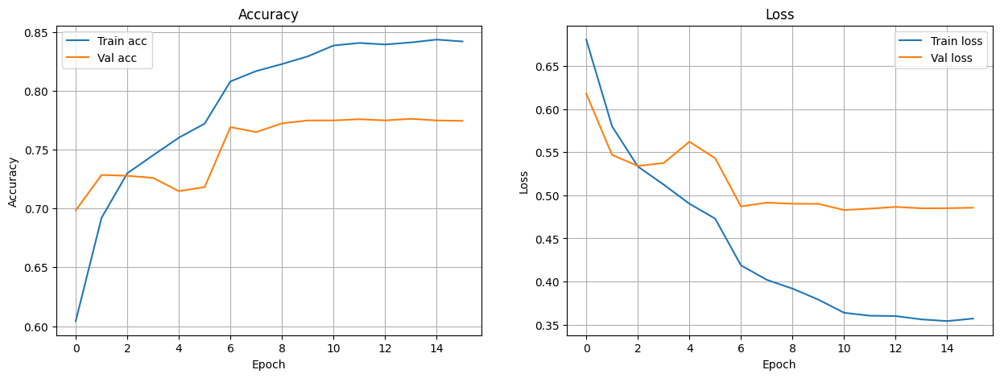

In [351]:
plot_loss_acc(history_cnn3)

### AUC

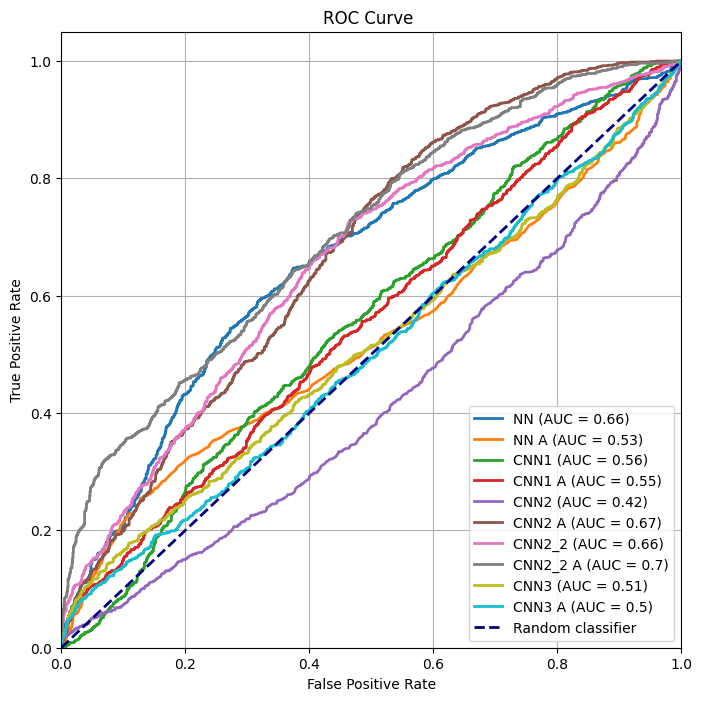

In [44]:
# plot_AUC(labels_test, predictions[:,1])
# plot_AUC(labels_test, predictions)
compare_models = {
    "NN": predictions_nn,
    "NN A": predictions_nn_aug,
    "CNN1": predictions_cnn1,
    "CNN1 A": predictions_cnn1_aug,
    "CNN2": predictions_cnn2,
    "CNN2 A": predictions_cnn2_aug,
    "CNN2_2": predictions_cnn2_2,
    "CNN2_2 A": predictions_cnn2_2_aug,
    "CNN3": predictions_cnn3,
    "CNN3 A": predictions_cnn3_aug
}
plot_AUC(labels_test,compare_models,figsize=(8,8))

### Confusion

array([[1., 0.],
       [1., 0.]])

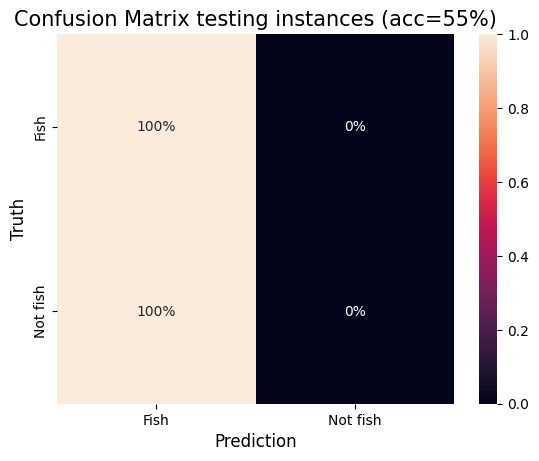

In [45]:
predictions = predictions_cnn2
# plot_confustion_matrix(labels_test, np.argmax(predictions, axis=-1),percent=True)
plot_confustion_matrix(labels_test, (predictions > 0.5).flatten(),percent=True)

### Class confidence per patch

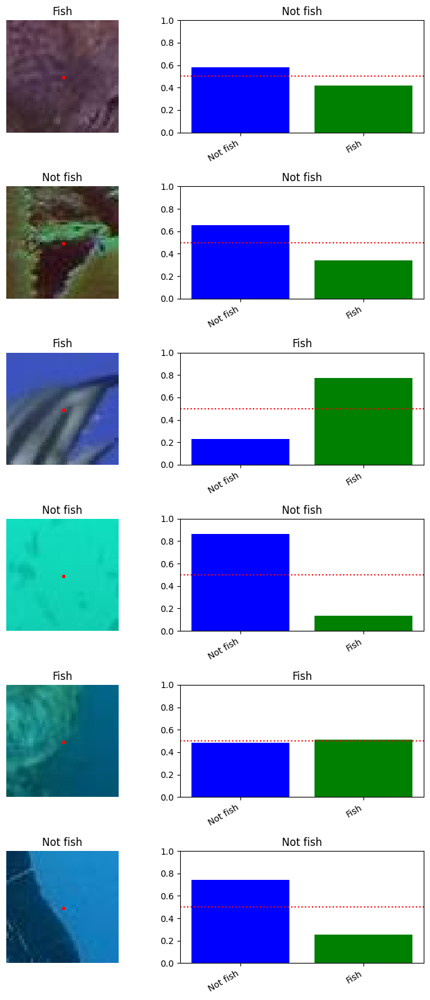

In [28]:
labelnames = ["Not fish", "Fish"]
patch_size = 50
# shuffle and pick at random
random_idxs = np.random.choice(len(patches_test), 6)
predictions = predictions_cnn2

fig, axes = plt.subplots(6, 2, figsize=(8, 16))
for idx,(im,prob) in enumerate(zip(labels_test[random_idxs],predictions[random_idxs])):
    axes[idx,0].imshow(patches_test[random_idxs[idx]])
    axes[idx,0].set_title(labelnames[int(im)])
    axes[idx,0].axis("off")
    axes[idx,0].plot(patch_size//2,patch_size//2,"r+")
    # axes[idx,1].bar(range(2),prob, color=["blue", "green"])
    axes[idx,1].bar(range(2),[1-prob[0],prob[0]], color=["blue", "green"])
    axes[idx,1].axhline(0.5, color="red", linestyle="dotted")
    axes[idx,1].set_ylim([0,1])
    axes[idx,1].set_xticks(range(2),labelnames)
    # axes[idx,1].set_title(labelnames[predictions[random_idxs[idx]].argmax()])
    axes[idx,1].set_title(labelnames[(predictions[random_idxs[idx]] > 0.5).astype(int)[0]])
    plt.setp(axes[idx,1].get_xticklabels(), rotation=30, horizontalalignment='right')
fig.tight_layout()

In [ ]:
# # Visualize filters in a layer
# import itertools
# filters = model2.layers[3].get_weights()[0]
# filters.shape
# fig, axs = plt.subplots(nrows = filters.shape[2], ncols = filters.shape[3], figsize=(20,10))
# for i,j in itertools.product(range(filters.shape[2]),range(filters.shape[3])):
#     axs[i,j].imshow(filters[:,:,i,j],vmin=-0.5,vmax=+0.5,cmap="gray")
#     axs[i,j].axis("off")

## Build a mask

### fn

In [396]:
def extract_10(im):
    size = 10
    center = np.array(im.shape[:2])//2
    return np.array([im[center[0]-size//2:center[0]+size//2,center[1]-size//2:center[1]+size//2,:]]).flatten()


def create_mask(image,stride=4,batch_size=64,type_="NN",model=None):
    patch_size = (50, 50)
    ignore = int(patch_size[0]/2)
    
    image = image.astype(float) / 255
    height, width = image.shape[:2]
    segmentation_mask = np.ones((height, width), dtype=np.float32)

#     patches = np.lib.stride_tricks.sliding_window_view(image, (patch_size[0], patch_size[1],3),axis=(0,1,2))
#     patches = patches[::stride, ::stride, :, :].reshape(-1, patch_size[0], patch_size[1], 3)
    patches = []
    # for y in range(0, height - patch_size[0] + 1, stride):
    #     for x in range(0, width - patch_size[1] + 1, stride):
    for y in range(ignore, height - patch_size[0] + ignore, stride):
        for x in range(ignore, width - patch_size[1] + ignore, stride):
            # patch = image[y:y + patch_size[0], x:x + patch_size[1]]
            patch = image[y-ignore:y+ignore, x-ignore:x + ignore]
            patches.append(patch)
    patches = np.array(patches) 


    if type_ == "NN" and model is not None:
        # predictions = model.predict(patches, batch_size=batch_size)[:,1]
        predictions = np.array(model.predict(patches, batch_size=batch_size))
    elif type_ == "RF" and clf_rf is not None:  
        patches_feat = []
        for patch in patches:
            patches_feat.append(extract_10(patch))
        patches_feat = np.array(patches_feat) 
        predictions = np.array(clf_rf.predict_proba(patches_feat))[:,1]
    else:
        raise ValueError("No model provided")
    
    index = 0
    for y in range(ignore, height - patch_size[0] + ignore, stride):
        for x in range(ignore, width - patch_size[1] + ignore, stride):
            pred_fish = predictions[index]
            if stride == 1:
                segmentation_mask[y,x] = pred_fish
            elif stride % 2 == 0:
                y1, y2 = y - stride // 2, y + stride // 2
                x1, x2 = x - stride // 2, x + stride // 2
                segmentation_mask[y1:y2,x1:x2] = pred_fish
            else:
                y1, y2 = y - stride // 2, y + stride // 2 + 1
                x1, x2 = x - stride // 2, x + stride // 2 + 1
                segmentation_mask[y1:y2,x1:x2] = pred_fish
            index += 1
    return segmentation_mask

### implementation

images:   0%|          | 0/7 [00:00<?, ?it/s]

32/32 [==============================] - 7s 203ms/step


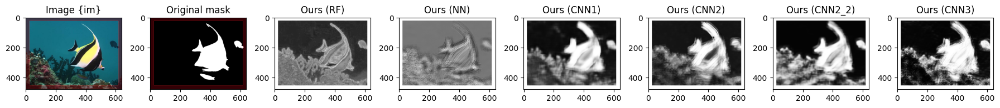

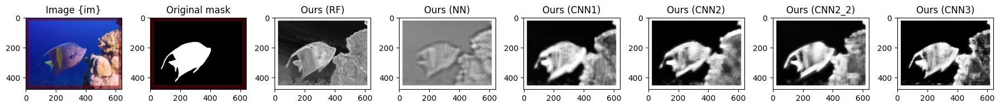

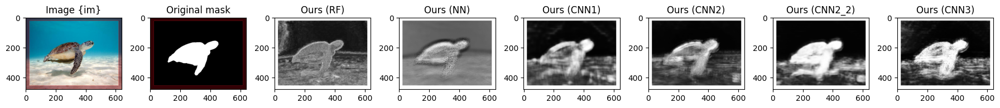

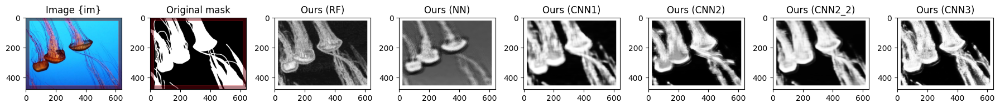

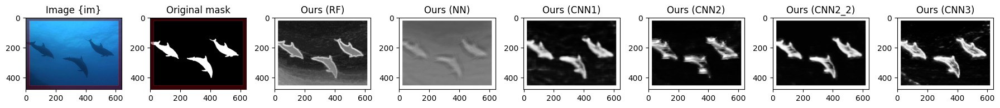

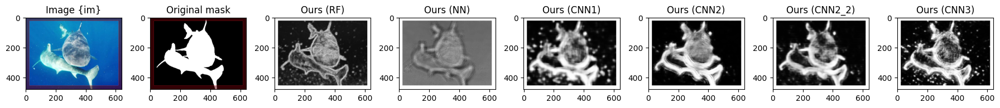

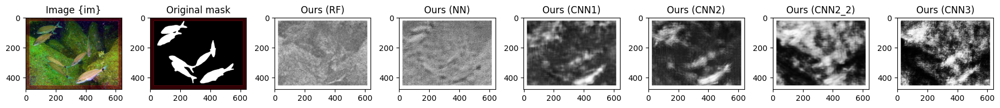

In [399]:
c

images:   0%|          | 0/7 [00:00<?, ?it/s]

32/32 [==============================] - 7s 222ms/step


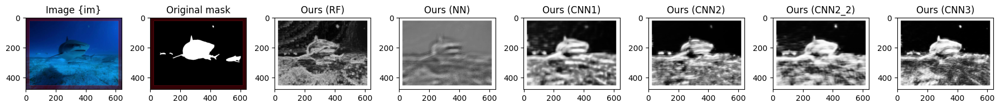

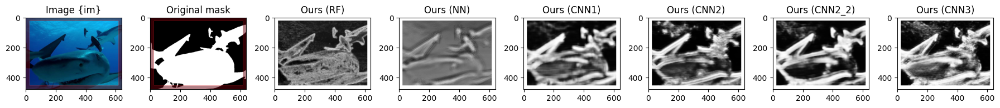

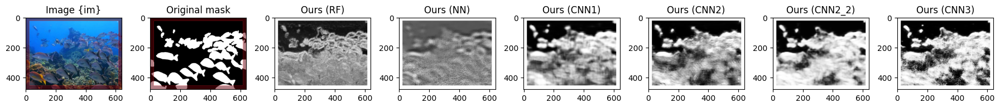

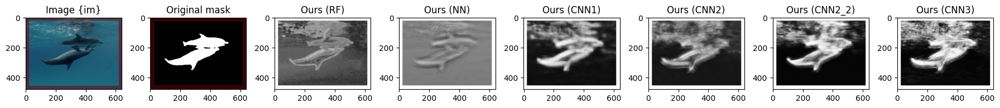

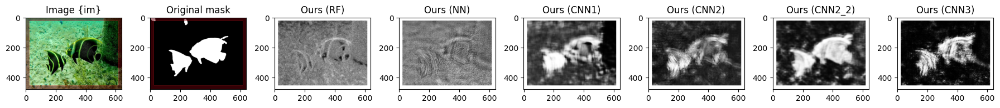

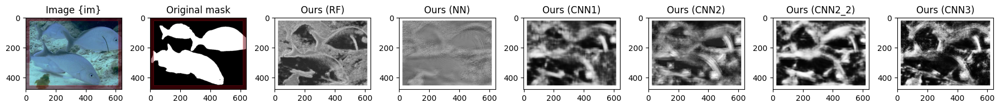

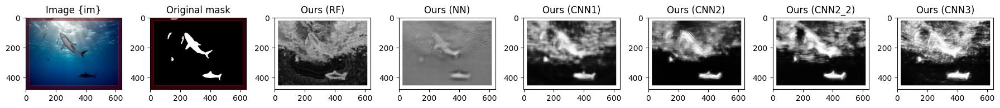

In [400]:
ignore  = 25
frame = np.zeros((480,640))
frame[:ignore,:] = 1
frame[:,:ignore] = 1
frame[-ignore:,:] = 1
frame[:,-ignore:] = 1

for im in tqdm(["f_r_1303_","f_r_1452_","f_r_1737_","f_r_1435_","f_r_1644_","f_r_644_","f_r_214_"],desc="images"):
    test_im = read_image(im + '.jpg', im_type="images", set_="test")
    test_mask = read_image(im + '.bmp', im_type="masks", set_="test")
    segmentation_mask_rf = create_mask(test_im,stride=4,type_="RF")
    segmentation_mask_nn1 = create_mask(test_im,stride=4,batch_size=512,type_="NN",model=model_nn)
    segmentation_mask_cnn1 = create_mask(test_im,stride=4,batch_size=512,type_="NN",model=model_cnn1)
    segmentation_mask_cnn2 = create_mask(test_im,stride=4,batch_size=512,type_="NN",model=model_cnn2)
    segmentation_mask_cnn2_2 = create_mask(test_im,stride=4,batch_size=512,type_="NN",model=good)
    segmentation_mask_cnn3 = create_mask(test_im,stride=4,batch_size=512,type_="NN",model=model_cnn3)
    fig, axes = plt.subplots(1,8,figsize=(18,7))
    axes[0].imshow(test_im)
    axes[0].imshow(frame ,alpha=0.5*(frame>0),cmap="Reds")
    axes[1].imshow(np.all(test_mask == (1, 1, 0), axis=-1), cmap="gray", vmin=0, vmax=1)
    axes[1].imshow(frame ,alpha=0.5*(frame>0),cmap="Reds")
    axes[2].imshow(segmentation_mask_rf, cmap="gray", vmin=0, vmax=1)
    axes[3].imshow(segmentation_mask_nn1, cmap="gray", vmin=0, vmax=1)
    axes[4].imshow(segmentation_mask_cnn1, cmap="gray", vmin=0, vmax=1)
    axes[5].imshow(segmentation_mask_cnn2, cmap="gray", vmin=0, vmax=1)
    axes[6].imshow(segmentation_mask_cnn2_2, cmap="gray", vmin=0, vmax=1)
    axes[7].imshow(segmentation_mask_cnn3, cmap="gray", vmin=0, vmax=1)
    
    axes[0].set_title(f"Image {im}")
    axes[1].set_title("Original mask")
    axes[2].set_title("Ours (RF)")
    axes[3].set_title("Ours (NN)")
    axes[4].set_title("Ours (CNN1)")
    axes[5].set_title("Ours (CNN2)")
    axes[6].set_title("Ours (CNN2_2)")
    axes[7].set_title("Ours (CNN3)")
    for ax in axes:
        ax.axis("off")
    plt.tight_layout()

images:   0%|          | 0/11 [00:00<?, ?it/s]

32/32 [==============================] - 10s 305ms/step


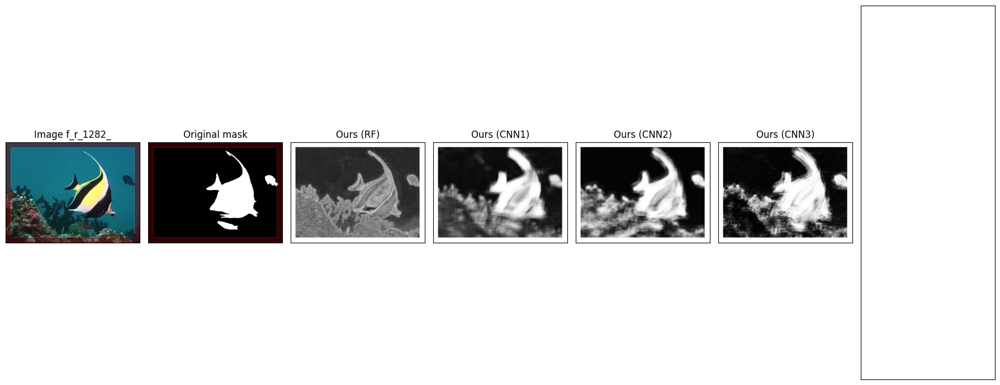

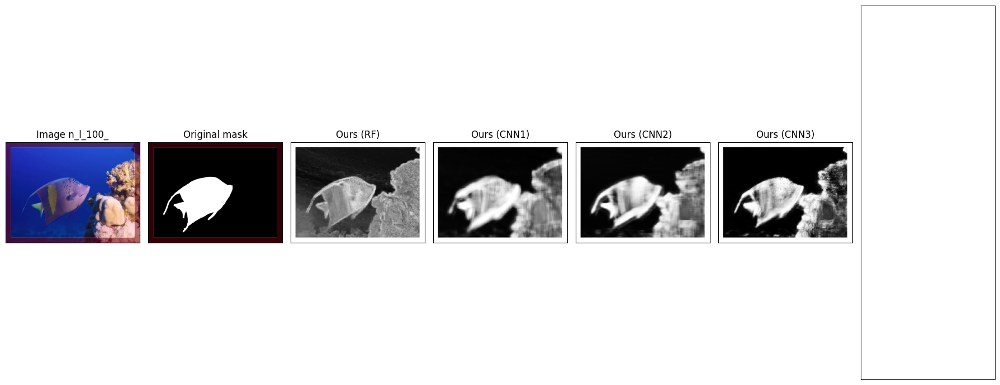

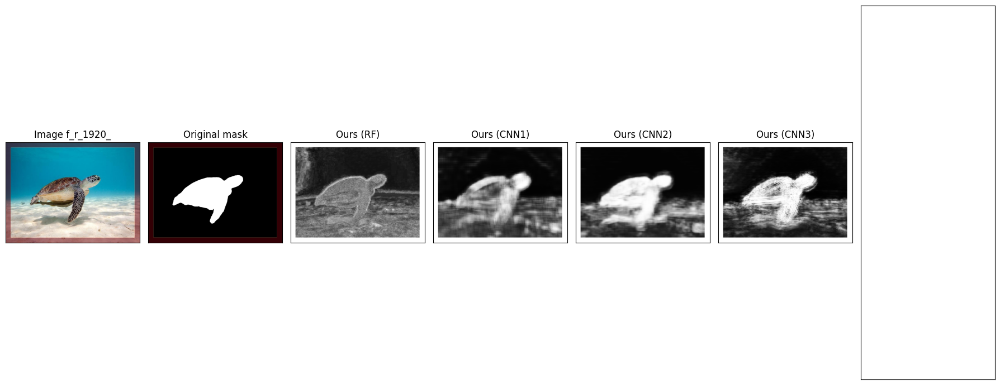

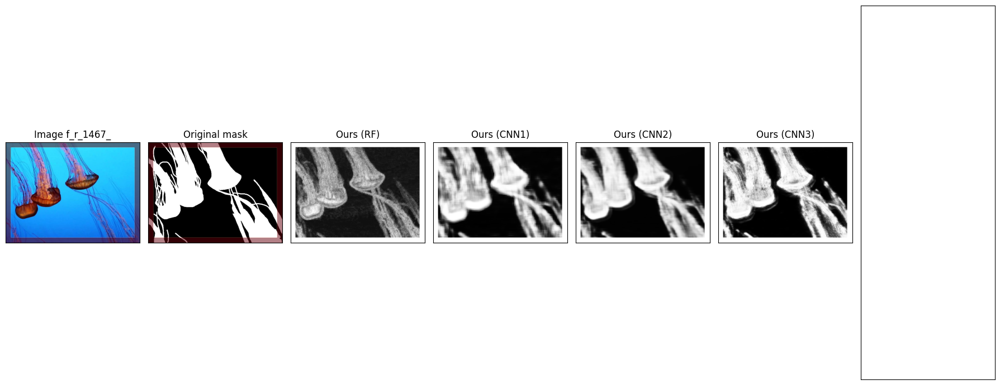

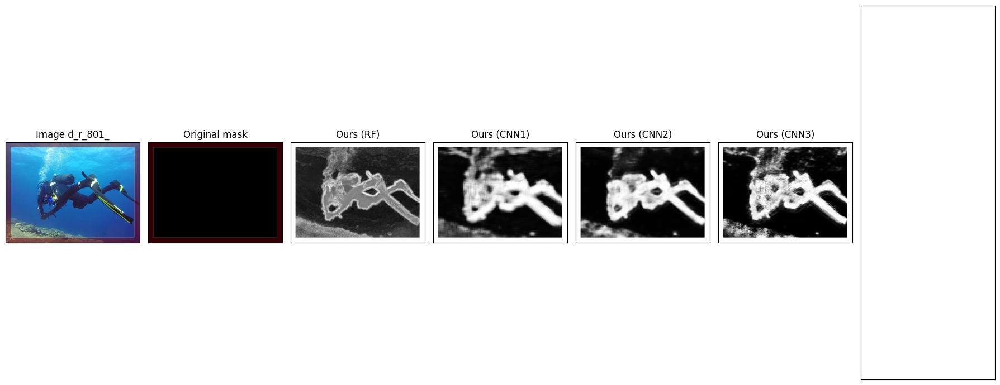

...

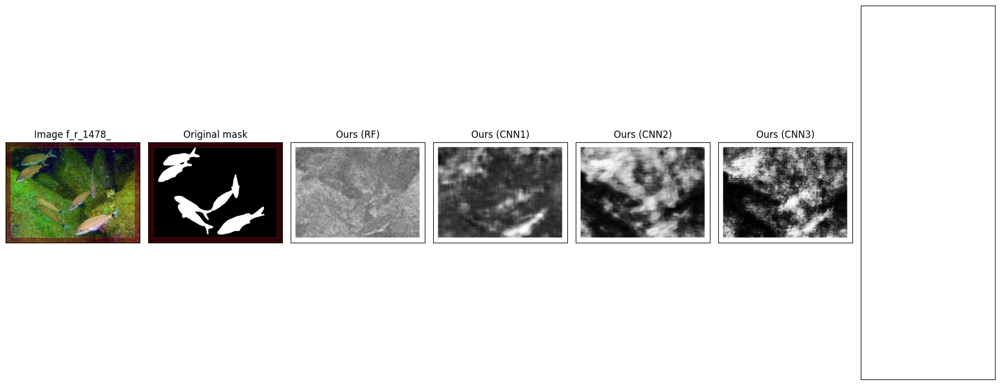

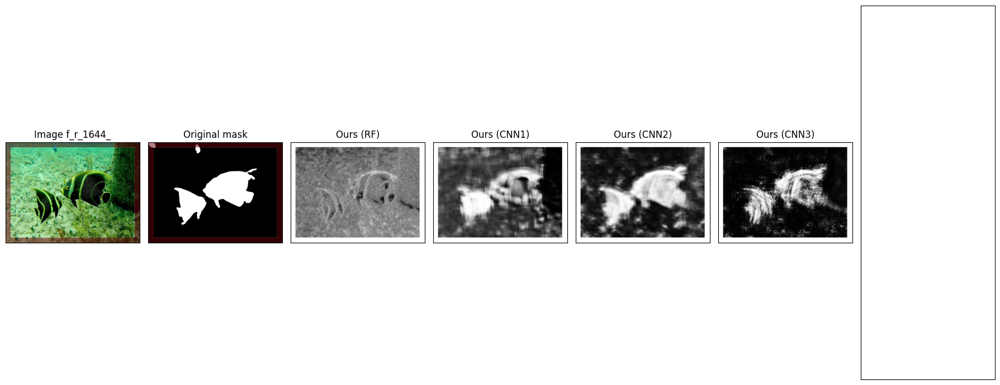

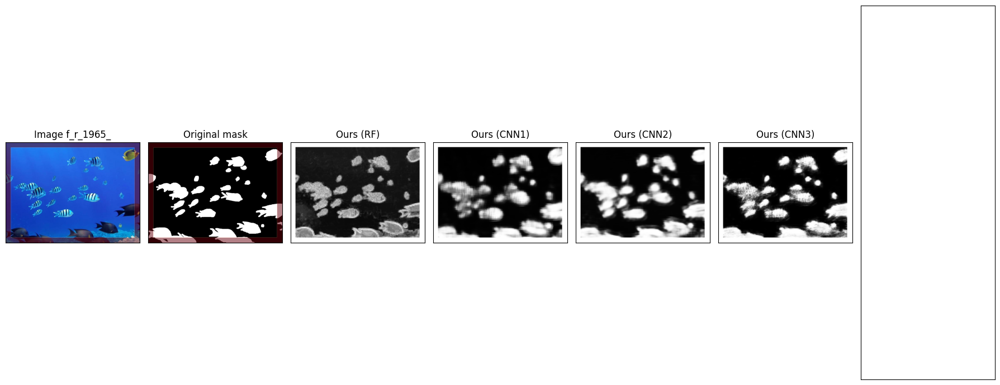

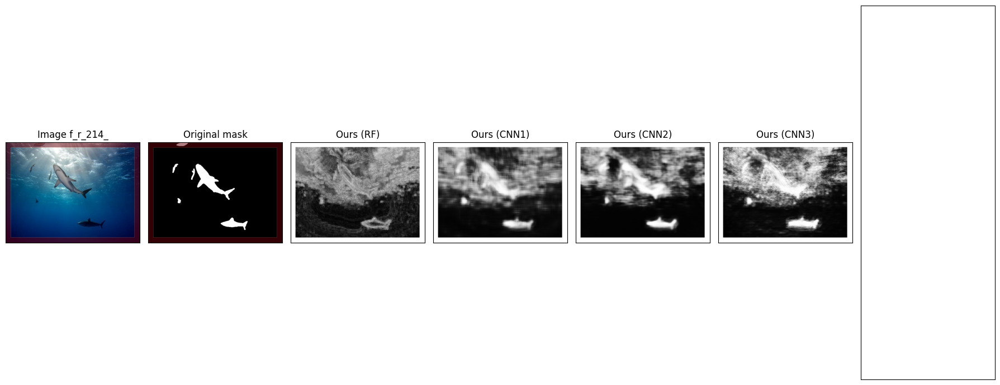

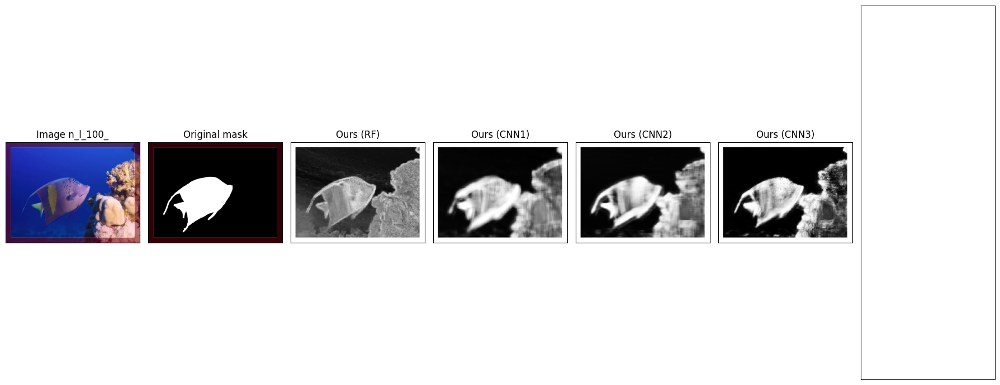

In [437]:
ims = ["f_r_1282_",
       "n_l_100_",
       "f_r_1920_",
       "f_r_1467_",
        "d_r_801_",
        "f_r_1229_",
        "f_r_1478_",
        "f_r_1644_",
        "f_r_1965_",
        "f_r_214_",
        "n_l_100_"]

ignore  = 25
frame = np.zeros((480,640))
frame[:ignore,:] = 1
frame[:,:ignore] = 1
frame[-ignore:,:] = 1
frame[:,-ignore:] = 1

for im in tqdm(ims,desc="images"):
    test_im = read_image(im + '.jpg', im_type="images", set_="test")
    test_mask = read_image(im + '.bmp', im_type="masks", set_="test")
    segmentation_mask_rf = create_mask(test_im,stride=4,type_="RF")
    segmentation_mask_cnn1 = create_mask(test_im,stride=4,batch_size=512,type_="NN",model=model_cnn1)
    # segmentation_mask_cnn2 = create_mask(test_im,stride=4,batch_size=512,type_="NN",model=model_cnn2)
    segmentation_mask_cnn2_2 = create_mask(test_im,stride=4,batch_size=512,type_="NN",model=good)
    segmentation_mask_cnn3 = create_mask(test_im,stride=4,batch_size=512,type_="NN",model=model_cnn3)
    fig, axes = plt.subplots(1,7,figsize=(18,5))
    axes[0].imshow(test_im)
    axes[0].imshow(frame ,alpha=0.5*(frame>0),cmap="Reds")
    axes[1].imshow(np.all(test_mask == (1, 1, 0), axis=-1), cmap="gray", vmin=0, vmax=1)
    axes[1].imshow(frame ,alpha=0.5*(frame>0),cmap="Reds")
    axes[2].imshow(segmentation_mask_rf, cmap="gray", vmin=0, vmax=1)
    axes[3].imshow(segmentation_mask_cnn1, cmap="gray", vmin=0, vmax=1)
    # axes[4].imshow(segmentation_mask_cnn2, cmap="gray", vmin=0, vmax=1)
    axes[4].imshow(segmentation_mask_cnn2_2, cmap="gray", vmin=0, vmax=1)
    axes[5].imshow(segmentation_mask_cnn3, cmap="gray", vmin=0, vmax=1)
    
    axes[0].set_title(f"Image {im}")
    axes[1].set_title("Original mask")
    axes[2].set_title("Ours (RF)")
    axes[3].set_title("Ours (CNN1)")
    axes[4].set_title("Ours (CNN2)")
    # axes[5].set_title("Ours (CNN2_2)")
    axes[5].set_title("Ours (CNN3)")
    for ax in axes:
        ax.set_xticks([])
        ax.set_yticks([])
    plt.tight_layout()

images:   0%|          | 0/92 [00:00<?, ?it/s]

3/3 [==============================] - 1s 338ms/step


C:\Users\kaisb\AppData\Local\Temp\ipykernel_19372\1237371979.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1,4,figsize=(18,5))


3/3 [==============================] - 1s 414ms/step


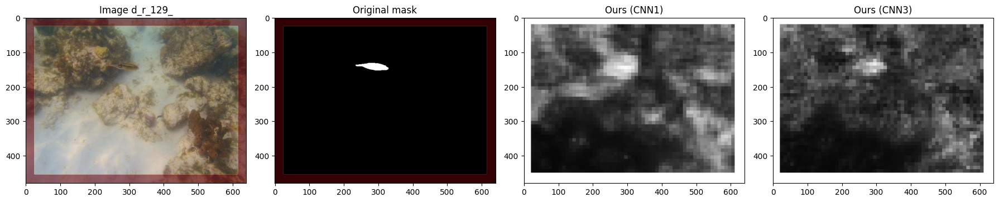

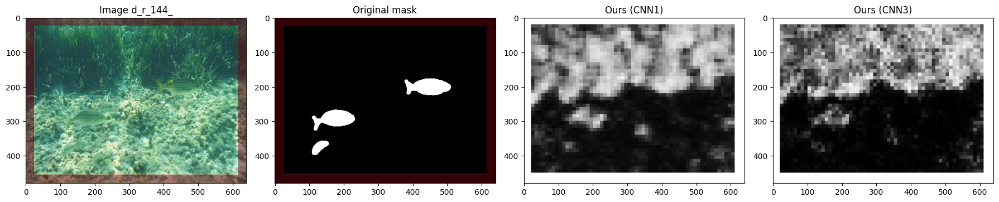

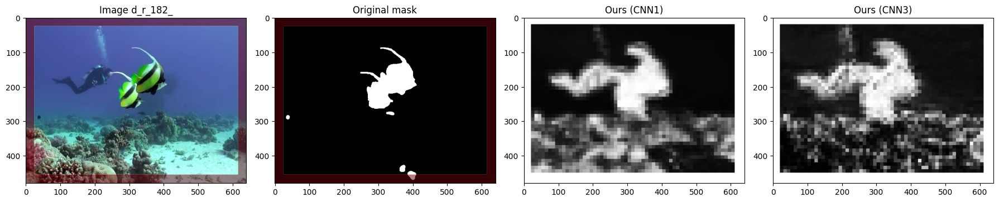

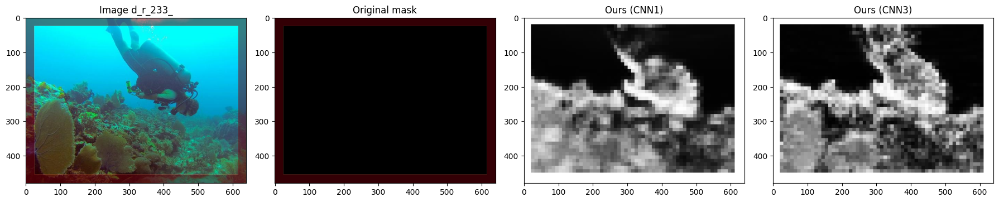

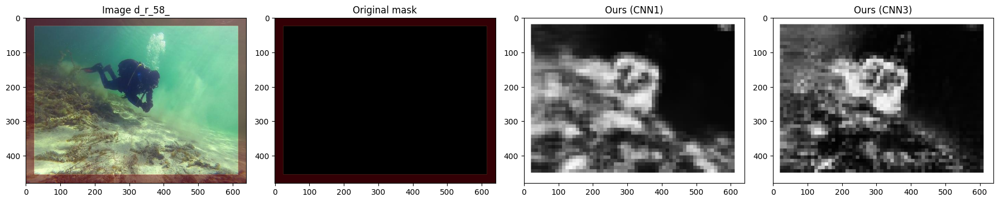

...

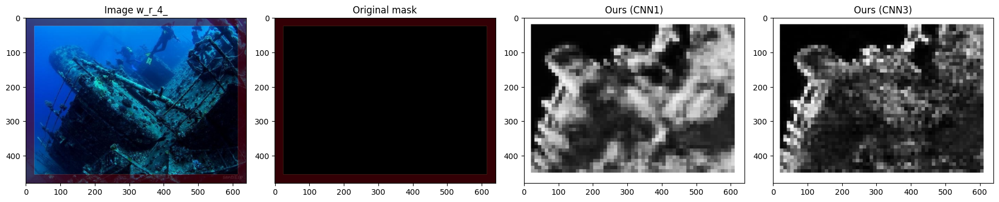

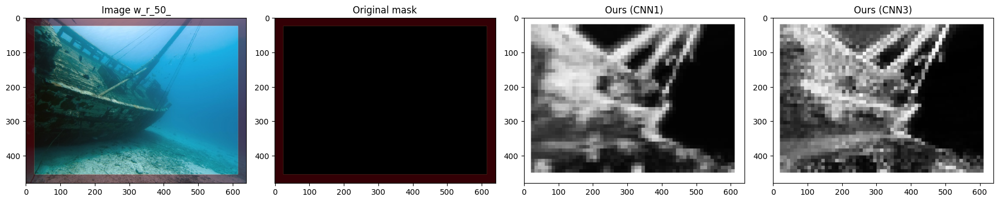

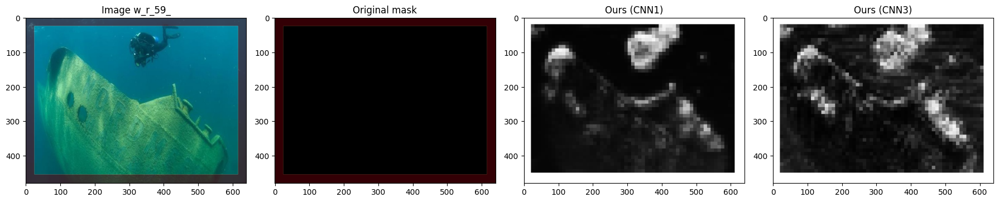

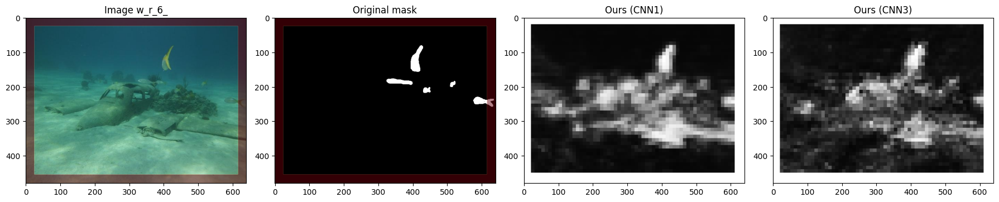

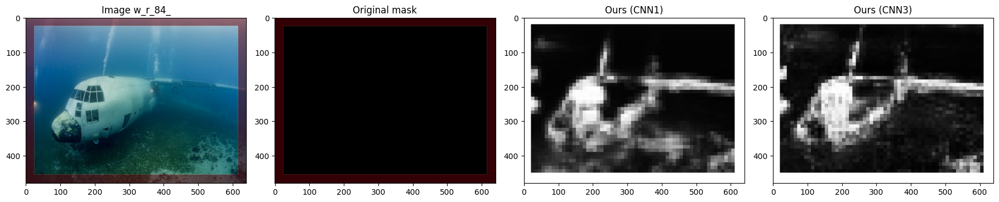

In [401]:
ignore  = 25
frame = np.zeros((480,640))
frame[:ignore,:] = 1
frame[:,:ignore] = 1
frame[-ignore:,:] = 1
frame[:,-ignore:] = 1
ims = file_names_test
amt = len(ims)
# amt = 1

for im in tqdm(ims[:amt],desc="images"):
    test_im = read_image(im + '.jpg', im_type="images", set_="test")
    test_mask = read_image(im + '.bmp', im_type="masks", set_="test")
    # segmentation_mask_rf = create_mask(test_im,stride=10,type_="RF")
    segmentation_mask_cnn1 = create_mask(test_im,stride=10,batch_size=1024,type_="NN",model=good)
    segmentation_mask_cnn2 = create_mask(test_im,stride=10,batch_size=1024,type_="NN",model=model_cnn2)
    segmentation_mask_cnn3 = create_mask(test_im,stride=10,batch_size=1024,type_="NN",model=model_cnn3)

    fig, axes = plt.subplots(1,5,figsize=(18,5))
    axes[0].imshow(test_im)
    axes[0].imshow(frame ,alpha=0.5*(frame>0),cmap="Reds")
    axes[1].imshow(np.all(test_mask == (1, 1, 0), axis=-1), cmap="gray", vmin=0, vmax=1)
    axes[1].imshow(frame ,alpha=0.5*(frame>0),cmap="Reds")
    axes[2].imshow(segmentation_mask_cnn1, cmap="gray", vmin=0, vmax=1)
    axes[3].imshow(segmentation_mask_cnn2, cmap="gray", vmin=0, vmax=1)
    axes[4].imshow(segmentation_mask_cnn3, cmap="gray", vmin=0, vmax=1)
    
    
    axes[0].set_title(f"Image {im}")
    axes[1].set_title("Original mask")
    axes[2].set_title("Ours (CNN1)")
    axes[3].set_title("Ours (CNN2)")
    axes[4].set_title("Ours (CNN3)")
    for ax in axes:
        ax.axis("off")
    plt.tight_layout()